# Face Generation

In this project, you'll define and train a Generative Adverserial network of your own creation on a dataset of faces. Your goal is to get a generator network to generate *new* images of faces that look as realistic as possible!

The project will be broken down into a series of tasks from **defining new architectures training adversarial networks**. At the end of the notebook, you'll be able to visualize the results of your trained Generator to see how it performs; your generated samples should look like fairly realistic faces with small amounts of noise.

### Get the Data

You'll be using the [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) to train your adversarial networks.

This dataset has higher resolution images than datasets you have previously worked with (like MNIST or SVHN) you've been working with, and so, you should prepare to define deeper networks and train them for a longer time to get good results. It is suggested that you utilize a GPU for training.

### Pre-processed Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. Some sample data is show below.

<img src='assets/processed_face_data.png' width=60% />

> If you are working locally, you can download this data [by clicking here](https://s3.amazonaws.com/video.udacity-data.com/topher/2018/November/5be7eb6f_processed-celeba-small/processed-celeba-small.zip)

This is a zip file that you'll need to extract in the home directory of this notebook for further loading and processing. After extracting the data, you should be left with a directory of data `processed-celeba-small/`.

In [30]:
# Pre-requisite: Select PyTorch 2.0.0 kernel

In [31]:
# Rubric: https://review.udacity.com/#!/rubrics/4801/view


In [32]:
# run this once to unzip the file
# !unzip processed-celeba-small.zip

In [33]:
from glob import glob
from typing import Tuple, Callable, Dict

import matplotlib.pyplot as plt
import numpy as np
import torch
from PIL import Image
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import Compose, ToTensor
from torchvision import datasets
import torchvision
import os
import multiprocessing
from tqdm import tqdm

import tests

device = 'cuda'


In [34]:
data_dir = 'processed-celeba-small/celeba'

## Data pipeline

The [CelebA](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations. Since you're going to be generating faces, you won't need the annotations, you'll only need the images. Note that these are color images with [3 color channels (RGB)](https://en.wikipedia.org/wiki/Channel_(digital_image)#RGB_Images) each.

### Pre-process and Load the Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. This *pre-processed* dataset is a smaller subset of the very large CelebA dataset and contains roughly 30,000 images. 

Your first task consists in building the dataloader. To do so, you need to do the following:
* implement the get_transforms function
* create a custom Dataset class that reads the CelebA data

### Exercise: implement the get_transforms function

The `get_transforms` function should output a [`torchvision.transforms.Compose`](https://pytorch.org/vision/stable/generated/torchvision.transforms.Compose.html#torchvision.transforms.Compose) of different transformations. You have two constraints:
* the function takes a tuple of size as input and should **resize the images** to the input size
* the output images should have values **ranging from -1 to 1**

In [35]:
def get_transforms(size: Tuple[int, int]) -> Callable:
    """ Transforms to apply to the image."""
    # TODO: edit this function by appening transforms to the below list
        
    transforms = [
        torchvision.transforms.Resize(size),   
        torchvision.transforms.ToTensor(),
        torchvision.transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ]        
    
    return Compose(transforms)

### Exercise: implement the DatasetDirectory class


The `DatasetDirectory` class is a torch Dataset that reads from the above data directory. The `__getitem__` method should output a transformed tensor and the `__len__` method should output the number of files in our dataset. You can look at [this custom dataset](https://pytorch.org/tutorials/beginner/basics/data_tutorial.html#creating-a-custom-dataset-for-your-files) for ideas. 

In [36]:
class DatasetDirectory(Dataset):
    """
    A custom dataset class that loads images from folder.
    args:
    - directory: location of the images
    - transform: transform function to apply to the images
    - extension: file format
    """
    def __init__(self, 
                 directory: str, 
                 transforms: Callable = None, 
                 extension: str = '.jpg'):
        # TODO: implement the init method
        
        self.directory = directory
        self.transforms = transforms
        self.extension = extension
        self.filenames = [f for f in os.listdir(directory) if f.endswith(extension)]


    def __len__(self) -> int:
        """ returns the number of items in the dataset """
        # TODO: return the number of elements in the dataset
        return len(self.filenames)

    def __getitem__(self, index: int) -> torch.Tensor:
        """ load an image and apply transformation """
        # TODO: return the index-element of the dataset
        
        filename = self.filenames[index]
        filepath = os.path.join(self.directory, filename)
        image = Image.open(filepath)
        
        if self.transforms:
            image = self.transforms(image)
        
        return image        

In [37]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your dataset implementation
dataset = DatasetDirectory(data_dir, get_transforms((64, 64)))
tests.check_dataset_outputs(dataset)

Congrats, your dataset implementation passed all the tests


The functions below will help you visualize images from the dataset.

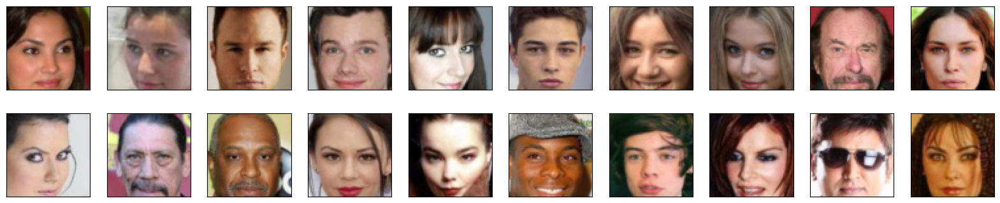

In [38]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def denormalize(images):
    """Transform images from [-1.0, 1.0] to [0, 255] and cast them to uint8."""
    return ((images + 1.) / 2. * 255).astype(np.uint8)

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(20, 4))
plot_size=20
for idx in np.arange(plot_size):
    ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
    img = dataset[idx].numpy()
    img = np.transpose(img, (1, 2, 0))
    img = denormalize(img)
    ax.imshow(img)

## Model implementation

As you know, a GAN is comprised of two adversarial networks, a discriminator and a generator. Now that we have a working data pipeline, we need to implement the discriminator and the generator. 

Feel free to implement any additional class or function.

### Exercise: Create the discriminator

The discriminator's job is to score real and fake images. You have two constraints here:
* the discriminator takes as input a **batch of 64x64x3 images**
* the output should be a single value (=score)

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips
* To scale down from the input image, you can either use `Conv2d` layers with the correct hyperparameters or Pooling layers.
* If you plan on using gradient penalty, do not use Batch Normalization layers in the discriminator.

In [39]:
from torch.nn import Module
import torch.nn as nn
import torch.nn.functional as F

In [40]:
def conv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=True):
    """Creates a convolutional layer, with optional batch normalization.
    """
    layers = []
    conv_layer = nn.Conv2d(in_channels=in_channels, out_channels=out_channels, 
                           kernel_size=kernel_size, stride=stride, padding=padding, bias=False)
    
    layers.append(conv_layer)

    if batch_norm:
        layers.append(nn.BatchNorm2d(out_channels))
    return nn.Sequential(*layers)

class Discriminator(Module):        
    def __init__(self, conv_dim=64):
        super(Discriminator, self).__init__()
        # TODO: instantiate the different layers
        
        self.conv1 = conv(3, conv_dim, 4, batch_norm=False) # x, y = 64, depth 64  (64, 64, 3) -> (32, 32, 64)
        self.conv2 = conv(conv_dim, conv_dim*2, 4) # (32, 32, 128)                 (32, 32, 64) -> (16, 16, 128)
        self.conv3 = conv(conv_dim*2, conv_dim*4, 4) # (16, 16, 256)               (16, 16, 128) -> (8, 8, 256)
        self.conv4 = conv(conv_dim*4, conv_dim*8, 4) # (8, 8, 512)                 (8, 8, 256) -> (4, 4, 512)
        
        self.conv5 = conv(conv_dim*8, 1, 4, stride=1, padding=0, batch_norm=False) # (4, 4, 512) -> (1, 1, 1)    
        
        # According to the paper: "In the LeakyReLU, the slope of the leak was set to 0.2 in all models"        
        self.activation = nn.LeakyReLU(0.2)
        
        
    def forward(self, x: torch.Tensor):
        out = self.activation(self.conv1(x))
        out = self.activation(self.conv2(out))
        out = self.activation(self.conv3(out))
        out = self.activation(self.conv4(out))
        out = self.conv5(out)
        
        return out

In [41]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to check your discriminator implementation
discriminator = Discriminator()

print(discriminator)
tests.check_discriminator(discriminator)

Discriminator(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv4): Sequential(
    (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv5): Sequential(
    (0): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
  (activation): LeakyReLU(negative_slope=0.2)
)
Congrats, your discriminator implementation passed all the tests


### Exercise: create the generator

The generator's job creates the "fake images" and learns the dataset distribution. You have three constraints here:
* the generator takes as input a vector of dimension `[batch_size, latent_dimension, 1, 1]`
* the generator must outputs **64x64x3 images**

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips:
* to scale up from the latent vector input, you can use `ConvTranspose2d` layers
* as often with Gan, **Batch Normalization** helps with training

In [42]:
# helper deconv function
def deconv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=True):
    """Creates a transposed-convolutional layer, with optional batch normalization.
    """
    # create a sequence of transpose + optional batch norm layers
    layers = []
    transpose_conv_layer = nn.ConvTranspose2d(in_channels, out_channels, 
                                              kernel_size, stride, padding, bias=False)
    # append transpose convolutional layer
    layers.append(transpose_conv_layer)
    
    if batch_norm:
        # append batchnorm layer
        layers.append(nn.BatchNorm2d(out_channels))
        
    return nn.Sequential(*layers)

class Generator(Module):
    def __init__(self, latent_dim: int):
        super(Generator, self).__init__()
      
        # First deconv layer: Takes latent vector input and outputs a feature map. 
        # Used Transp Convolution instead of FC layer for simplificity
        self.deconv1 = deconv(latent_dim, 1024, kernel_size=4, stride=1, padding=0, batch_norm=True)
        
        # Second deconv layer: Upsamples the feature map to a larger size
        self.deconv2 = deconv(1024, 512, kernel_size=4, stride=2, padding=1, batch_norm=True)
        
        # Third deconv layer
        self.deconv3 = deconv(512, 256, kernel_size=4, stride=2, padding=1, batch_norm=True)
        
        # Fourth deconv layer
        self.deconv4 = deconv(256, 128, kernel_size=4, stride=2, padding=1, batch_norm=True)
        
        # Fifth deconv layer: Outputs the final 64x64x3 image
        self.deconv5 = deconv(128, 3, kernel_size=4, stride=2, padding=1, batch_norm=False)
    
    def forward(self, x: torch.Tensor):
        x = F.relu(self.deconv1(x))
        x = F.relu(self.deconv2(x))
        x = F.relu(self.deconv3(x))
        x = F.relu(self.deconv4(x))    
        x = torch.tanh(self.deconv5(x))
        
        return x

In [43]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your generator implementation
latent_dim = 128
generator = Generator(latent_dim)
tests.check_generator(generator, latent_dim)

Congrats, your generator implementation passed all the tests


## Optimizer

In the following section, we create the optimizers for the generator and discriminator. You may want to experiment with different optimizers, learning rates and other hyperparameters as they tend to impact the output quality.

### Exercise: implement the optimizers

In [44]:
import torch.optim as optim


def create_optimizers(generator: Module, discriminator: Module):    
    lr = 0.0002
    # From the paper: "Additionally, we found leaving the momentum term β1 at the suggested value of 0.9 resulted in training oscillation 
    # and instability while reducing it to 0.5 helped stabilize training"
    betal=0.5
    beta2=0.999 # default value

    """ This function should return the optimizers of the generator and the discriminator """
    g_optimizer = optim.Adam(generator.parameters(), lr, [betal, beta2])
    d_optimizer = optim.Adam(discriminator.parameters(), lr, [betal, beta2])
    
    return g_optimizer, d_optimizer

## Losses implementation

In this section, we are going to implement the loss function for the generator and the discriminator. You can and should experiment with different loss function.

Some tips:
* You can choose the commonly used the binary cross entropy loss or select other losses we have discovered in the course, such as the Wasserstein distance.
* You may want to implement a gradient penalty function as discussed in the course. It is not required and the code will work whether you implement it or not.

### Exercise: implement the generator loss

The generator's goal is to get the discriminator to think its generated images (= "fake" images) are real.

In [74]:
def real_loss(D_out, smooth=False):
    batch_size = D_out.size(0)

    # label smoothing
    if smooth:
        # Generates values between 0.7 and 1.2
        labels = 0.5 * torch.rand(batch_size) + 0.7
        
        # labels = torch.ones(batch_size)*0.9        
    else:
        labels = torch.ones(batch_size) # real labels = 1

    labels = labels.to(device)        
    criterion = nn.BCEWithLogitsLoss()
    loss = criterion(D_out.squeeze(), labels)
    
    return loss

def fake_loss(D_out, smooth=False):
    batch_size = D_out.size(0)
    
    if smooth:
        # Generates values between 0 and 0.3
        labels = 0.3 * torch.rand(batch_size)
    else:
        labels = torch.zeros(batch_size) # fake labels = 0
    
    labels = labels.to(device)    
    criterion = nn.BCEWithLogitsLoss()    
    loss = criterion(D_out.squeeze(), labels)
    
    return loss

In [46]:
def generator_loss(fake_logits):
    """ Generator loss, takes the fake scores as inputs. """
    
    # use real loss to flip labels
    loss = real_loss(fake_logits)
    
    return loss

### Exercise: implement the discriminator loss

We want the discriminator to give high scores to real images and low scores to fake ones and the discriminator loss should reflect that.

In [75]:
def discriminator_loss(real_logits, fake_logits):
    """ Discriminator loss, takes the fake and real logits as inputs. """
        
    d_real_loss = real_loss(real_logits, True) # Label smoothing 
    d_fake_loss = fake_loss(fake_logits, True)
            
    loss = d_real_loss + d_fake_loss
    
    return loss

### Exercise (Optional): Implement the gradient Penalty

In the course, we discussed the importance of gradient penalty in training certain types of Gans. Implementing this function is not required and depends on some of the design decision you made (discriminator architecture, loss functions).

In [48]:
def gradient_penalty(discriminator, real_samples, fake_samples):
    """ This function enforces """
    gp = 0
    
    # TODO (Optional): implement the gradient penalty
    return gp

## Training


Training will involve alternating between training the discriminator and the generator. You'll use your functions real_loss and fake_loss to help you calculate the discriminator losses.

* You should train the discriminator by alternating on real and fake images
* Then the generator, which tries to trick the discriminator and should have an opposing loss function

### Exercise: implement the generator step and the discriminator step functions

Each function should do the following:
* calculate the loss
* backpropagate the gradient
* perform one optimizer step

### Main training loop

You don't have to implement anything here but you can experiment with different hyperparameters.

In [49]:
from datetime import datetime

In [76]:
# you can experiment with different dimensions of latent spaces
latent_dim = 128

# update to cpu if you do not have access to a gpu
# device = 'cuda'

# number of epochs to train your model
n_epochs = 50

# number of images in each batch
batch_size = 128

In [80]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
print_every = 50

# Create optimizers for the discriminator D and generator G
generator = Generator(latent_dim).to(device)
discriminator = Discriminator().to(device)
g_optimizer, d_optimizer = create_optimizers(generator, discriminator)

dataloader = DataLoader(dataset, 
                        batch_size=64, 
                        shuffle=True, 
                        num_workers=4, 
                        drop_last=True,
                        pin_memory=False)

In [81]:
# DCGAN init weight
def init_model_weights(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)


# From DCGAN paper: "All weights were initialized from a zero-centered Normal distribution with standard deviation 0.02"

generator.apply(init_model_weights)
discriminator.apply(init_model_weights)


Discriminator(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv4): Sequential(
    (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv5): Sequential(
    (0): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
  (activation): LeakyReLU(negative_slope=0.2)
)

In [71]:
def generator_step(batch_size: int, latent_dim: int) -> Dict:
    """ One training step of the generator. """
    # TODO: implement the generator step (foward pass, loss calculation and backward pass)
    
    g_optimizer.zero_grad()
        
    # 1. Train with fake images and flipped labels
        
    # Generate fake images
    z = torch.randn(batch_size, latent_dim, 1, 1).float().to(device)
    
    # z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
    # z = torch.from_numpy(z).float()[:,:,None,None]
                
                
    z = z.to(device)
        
    fake_images = generator(z)
        
    # Compute the discriminator losses on fake images 
    # using flipped labels!
    D_fake = discriminator(fake_images)
                        
    # g_loss = real_loss(D_fake) # use real loss to flip labels
    g_loss = generator_loss(D_fake)
        
    # perform backprop
    g_loss.backward()
        
    g_optimizer.step()
        
    return {'loss': g_loss}


def discriminator_step(batch_size: int, latent_dim: int, real_images: torch.Tensor) -> Dict:
    """ One training step of the discriminator. """
    # TODO: implement the discriminator step (foward pass, loss calculation and backward pass)

    d_optimizer.zero_grad()
        
    # 1. Train with real images

    # Compute the discriminator losses on real images 
        
    D_real = discriminator(real_images)
    # d_real_loss = real_loss(D_real)
        
    # 2. Train with fake images
        
    # Generate fake images
    z = torch.randn(batch_size, latent_dim, 1, 1).float().to(device)
    # z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
    # z = torch.from_numpy(z).float()[:,:,None,None]    
            
    # z = torch.rand(batch_size, latent_dim, 1, 1) * 2 - 1                
        
    # z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
    # z = torch.from_numpy(z).float()
    z = z.to(device)
        
    fake_images = generator(z)
        
    # Compute the discriminator losses on fake images            
    D_fake = discriminator(fake_images)
    # d_fake_loss = fake_loss(D_fake)
        
    # add up loss and perform backprop
    # d_loss = d_real_loss + d_fake_loss
        
    d_loss = discriminator_loss(D_real, D_fake)
        
    d_loss.backward()
        
    d_optimizer.step()
        
    gp = None
    
    return {'loss': d_loss, 'gp': gp}

In [62]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def display(fixed_latent_vector: torch.Tensor):
    """ helper function to display images during training """
    fig = plt.figure(figsize=(14, 4))
    plot_size = 16
    for idx in np.arange(plot_size):
        ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
        img = fixed_latent_vector[idx, ...].detach().cpu().numpy()
        img = np.transpose(img, (1, 2, 0))
        img = denormalize(img)
        ax.imshow(img)
    plt.show()

### Exercise: implement the training strategy

You should experiment with different training strategies. For example:

* train the generator more often than the discriminator. 
* added noise to the input image
* use label smoothing

Implement with your training strategy below.

2024-01-25 00:15:30 | Epoch [1/50] | Batch 0/509 | d_loss: 1.3835 | g_loss: 0.7058
2024-01-25 00:15:32 | Epoch [1/50] | Batch 50/509 | d_loss: 0.6660 | g_loss: 2.0150
2024-01-25 00:15:35 | Epoch [1/50] | Batch 100/509 | d_loss: 0.7140 | g_loss: 2.3478
2024-01-25 00:15:38 | Epoch [1/50] | Batch 150/509 | d_loss: 0.7485 | g_loss: 2.0922
2024-01-25 00:15:41 | Epoch [1/50] | Batch 200/509 | d_loss: 0.6275 | g_loss: 2.1933
2024-01-25 00:15:44 | Epoch [1/50] | Batch 250/509 | d_loss: 0.8466 | g_loss: 3.0561
2024-01-25 00:15:47 | Epoch [1/50] | Batch 300/509 | d_loss: 1.7021 | g_loss: 2.6966
2024-01-25 00:15:50 | Epoch [1/50] | Batch 350/509 | d_loss: 1.1896 | g_loss: 2.1302
2024-01-25 00:15:53 | Epoch [1/50] | Batch 400/509 | d_loss: 1.2171 | g_loss: 1.3345
2024-01-25 00:15:56 | Epoch [1/50] | Batch 450/509 | d_loss: 1.1097 | g_loss: 1.3721
2024-01-25 00:15:59 | Epoch [1/50] | Batch 500/509 | d_loss: 1.0787 | g_loss: 1.6971


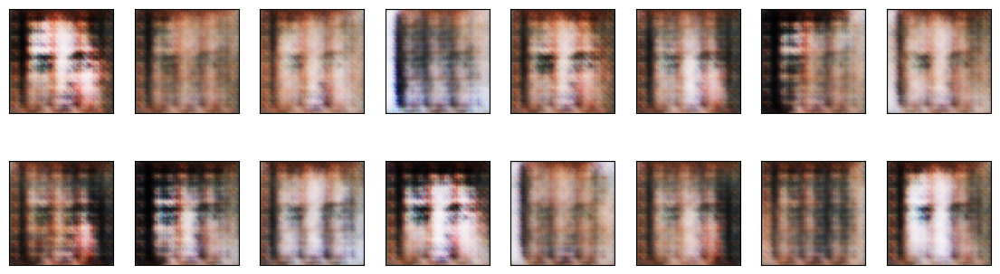

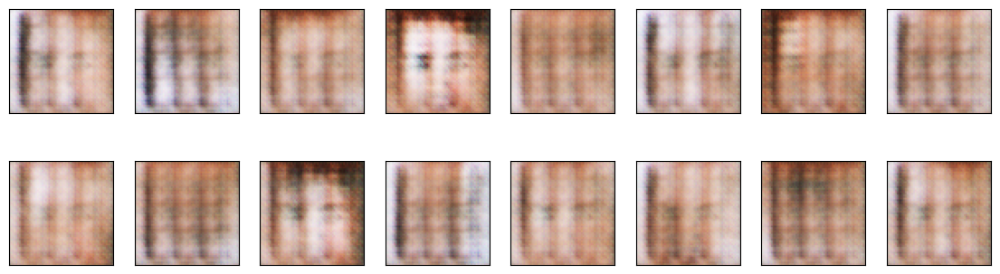

2024-01-25 00:16:01 | Epoch [2/50] | Batch 0/509 | d_loss: 1.0254 | g_loss: 1.6628
2024-01-25 00:16:04 | Epoch [2/50] | Batch 50/509 | d_loss: 1.1372 | g_loss: 1.8664
2024-01-25 00:16:07 | Epoch [2/50] | Batch 100/509 | d_loss: 0.9823 | g_loss: 1.5425
2024-01-25 00:16:09 | Epoch [2/50] | Batch 150/509 | d_loss: 1.2586 | g_loss: 1.1411
2024-01-25 00:16:12 | Epoch [2/50] | Batch 200/509 | d_loss: 1.2186 | g_loss: 1.1656
2024-01-25 00:16:15 | Epoch [2/50] | Batch 250/509 | d_loss: 1.3201 | g_loss: 0.9373
2024-01-25 00:16:18 | Epoch [2/50] | Batch 300/509 | d_loss: 1.0693 | g_loss: 1.6162
2024-01-25 00:16:21 | Epoch [2/50] | Batch 350/509 | d_loss: 1.1814 | g_loss: 1.3816
2024-01-25 00:16:24 | Epoch [2/50] | Batch 400/509 | d_loss: 1.2290 | g_loss: 1.0384
2024-01-25 00:16:27 | Epoch [2/50] | Batch 450/509 | d_loss: 1.1940 | g_loss: 1.3623
2024-01-25 00:16:30 | Epoch [2/50] | Batch 500/509 | d_loss: 1.2475 | g_loss: 2.1607


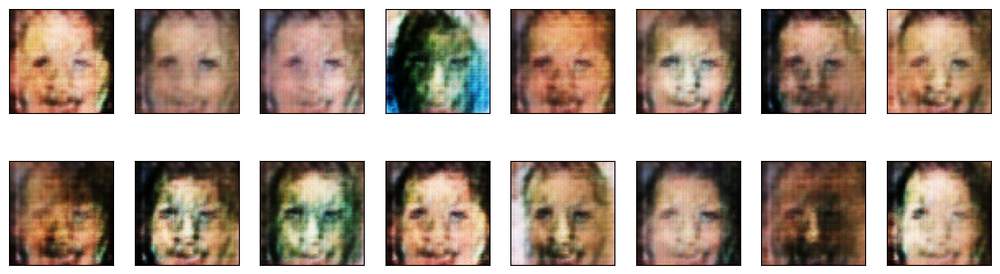

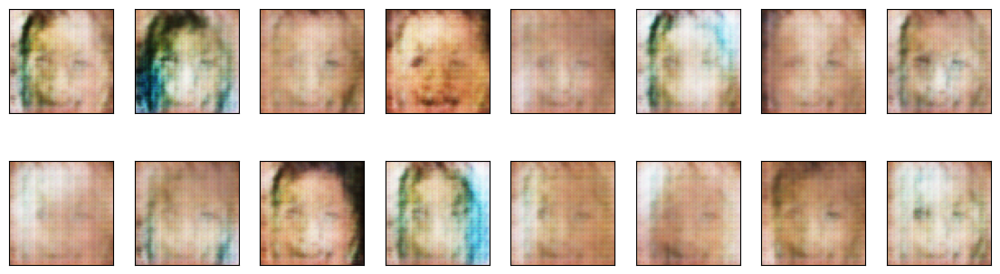

2024-01-25 00:16:32 | Epoch [3/50] | Batch 0/509 | d_loss: 1.0833 | g_loss: 1.5272
2024-01-25 00:16:35 | Epoch [3/50] | Batch 50/509 | d_loss: 1.1432 | g_loss: 1.7330
2024-01-25 00:16:38 | Epoch [3/50] | Batch 100/509 | d_loss: 1.2027 | g_loss: 1.2767
2024-01-25 00:16:41 | Epoch [3/50] | Batch 150/509 | d_loss: 1.2601 | g_loss: 1.3358
2024-01-25 00:16:43 | Epoch [3/50] | Batch 200/509 | d_loss: 1.1645 | g_loss: 1.2739
2024-01-25 00:16:46 | Epoch [3/50] | Batch 250/509 | d_loss: 1.1729 | g_loss: 1.3537
2024-01-25 00:16:49 | Epoch [3/50] | Batch 300/509 | d_loss: 1.4373 | g_loss: 1.1005
2024-01-25 00:16:52 | Epoch [3/50] | Batch 350/509 | d_loss: 1.2814 | g_loss: 1.3616
2024-01-25 00:16:55 | Epoch [3/50] | Batch 400/509 | d_loss: 1.3925 | g_loss: 1.7408
2024-01-25 00:16:58 | Epoch [3/50] | Batch 450/509 | d_loss: 1.1472 | g_loss: 1.2577
2024-01-25 00:17:01 | Epoch [3/50] | Batch 500/509 | d_loss: 1.3115 | g_loss: 1.0031


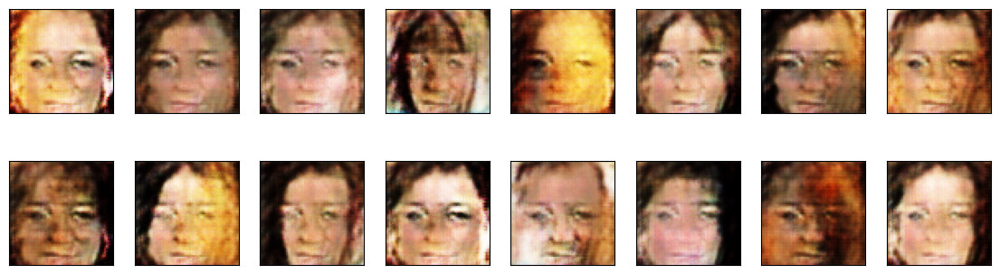

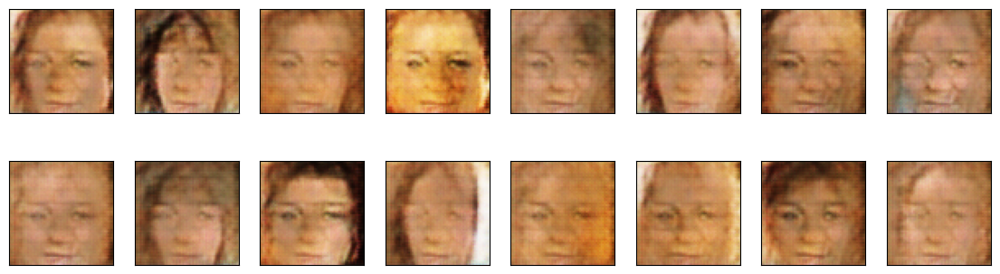

2024-01-25 00:17:03 | Epoch [4/50] | Batch 0/509 | d_loss: 1.0538 | g_loss: 1.5262
2024-01-25 00:17:06 | Epoch [4/50] | Batch 50/509 | d_loss: 1.2471 | g_loss: 1.3781
2024-01-25 00:17:09 | Epoch [4/50] | Batch 100/509 | d_loss: 1.1513 | g_loss: 1.3430
2024-01-25 00:17:12 | Epoch [4/50] | Batch 150/509 | d_loss: 1.2409 | g_loss: 0.9590
2024-01-25 00:17:15 | Epoch [4/50] | Batch 200/509 | d_loss: 1.0229 | g_loss: 1.2497
2024-01-25 00:17:18 | Epoch [4/50] | Batch 250/509 | d_loss: 1.0935 | g_loss: 1.0339
2024-01-25 00:17:21 | Epoch [4/50] | Batch 300/509 | d_loss: 1.3706 | g_loss: 1.3506
2024-01-25 00:17:23 | Epoch [4/50] | Batch 350/509 | d_loss: 1.0709 | g_loss: 1.4118
2024-01-25 00:17:26 | Epoch [4/50] | Batch 400/509 | d_loss: 1.1792 | g_loss: 1.3294
2024-01-25 00:17:29 | Epoch [4/50] | Batch 450/509 | d_loss: 1.1307 | g_loss: 1.0711
2024-01-25 00:17:32 | Epoch [4/50] | Batch 500/509 | d_loss: 1.2329 | g_loss: 1.7675


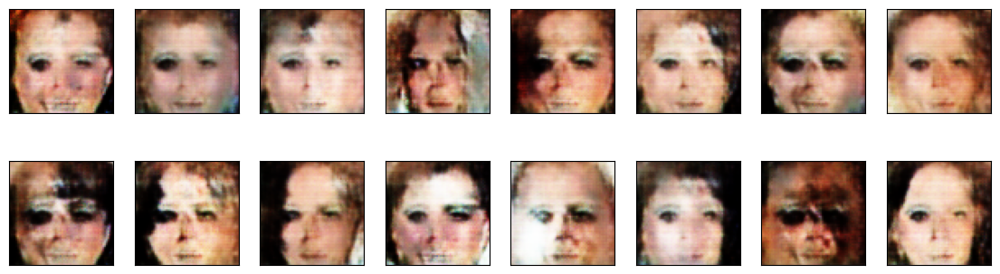

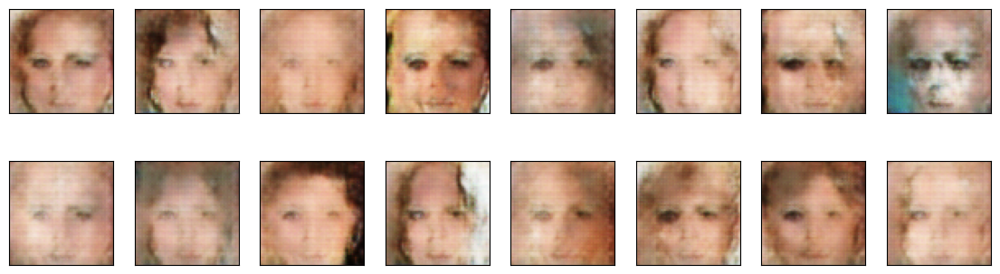

2024-01-25 00:17:34 | Epoch [5/50] | Batch 0/509 | d_loss: 1.0680 | g_loss: 1.2276
2024-01-25 00:17:37 | Epoch [5/50] | Batch 50/509 | d_loss: 1.1490 | g_loss: 1.3754
2024-01-25 00:17:40 | Epoch [5/50] | Batch 100/509 | d_loss: 1.1374 | g_loss: 0.9947
2024-01-25 00:17:43 | Epoch [5/50] | Batch 150/509 | d_loss: 1.1842 | g_loss: 1.4783
2024-01-25 00:17:46 | Epoch [5/50] | Batch 200/509 | d_loss: 1.0083 | g_loss: 1.4754
2024-01-25 00:17:49 | Epoch [5/50] | Batch 250/509 | d_loss: 1.1933 | g_loss: 1.3073
2024-01-25 00:17:52 | Epoch [5/50] | Batch 300/509 | d_loss: 1.3202 | g_loss: 1.2487
2024-01-25 00:17:54 | Epoch [5/50] | Batch 350/509 | d_loss: 0.9647 | g_loss: 1.7053
2024-01-25 00:17:57 | Epoch [5/50] | Batch 400/509 | d_loss: 1.1005 | g_loss: 0.9623
2024-01-25 00:18:00 | Epoch [5/50] | Batch 450/509 | d_loss: 1.0816 | g_loss: 1.2100
2024-01-25 00:18:03 | Epoch [5/50] | Batch 500/509 | d_loss: 1.1604 | g_loss: 0.9487


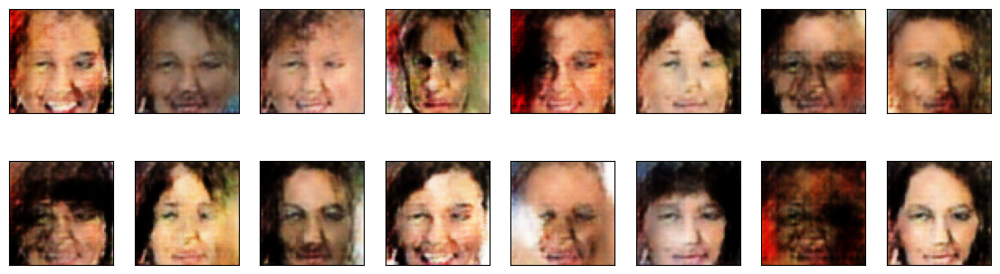

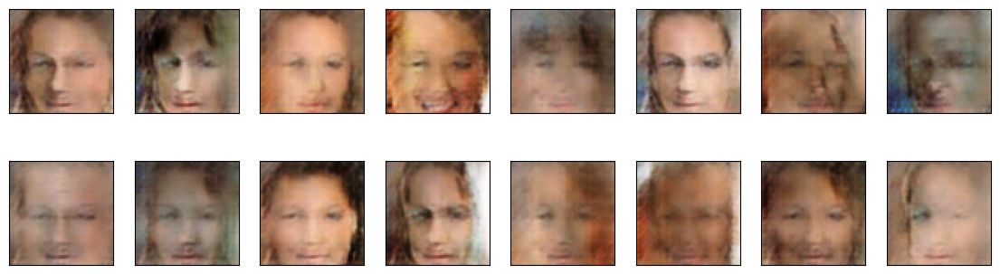

2024-01-25 00:18:05 | Epoch [6/50] | Batch 0/509 | d_loss: 1.2264 | g_loss: 0.9480
2024-01-25 00:18:08 | Epoch [6/50] | Batch 50/509 | d_loss: 1.2201 | g_loss: 0.8516
2024-01-25 00:18:11 | Epoch [6/50] | Batch 100/509 | d_loss: 1.1594 | g_loss: 1.1909
2024-01-25 00:18:14 | Epoch [6/50] | Batch 150/509 | d_loss: 1.2106 | g_loss: 0.5719
2024-01-25 00:18:17 | Epoch [6/50] | Batch 200/509 | d_loss: 1.0173 | g_loss: 1.4000
2024-01-25 00:18:20 | Epoch [6/50] | Batch 250/509 | d_loss: 1.1916 | g_loss: 1.0165
2024-01-25 00:18:23 | Epoch [6/50] | Batch 300/509 | d_loss: 1.0869 | g_loss: 1.3969
2024-01-25 00:18:26 | Epoch [6/50] | Batch 350/509 | d_loss: 1.0869 | g_loss: 1.5898
2024-01-25 00:18:28 | Epoch [6/50] | Batch 400/509 | d_loss: 1.0720 | g_loss: 1.3170
2024-01-25 00:18:31 | Epoch [6/50] | Batch 450/509 | d_loss: 0.9211 | g_loss: 1.4440
2024-01-25 00:18:34 | Epoch [6/50] | Batch 500/509 | d_loss: 1.1880 | g_loss: 1.9363


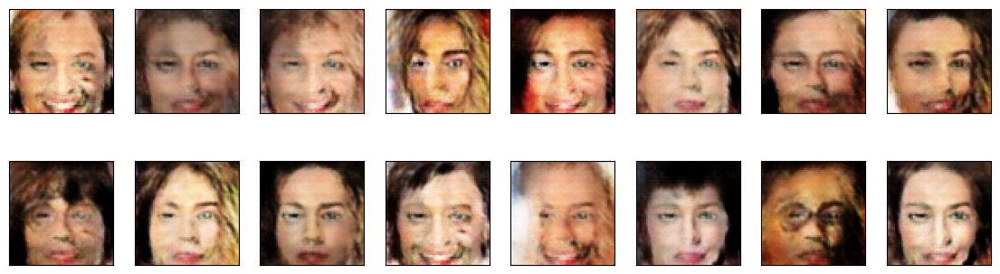

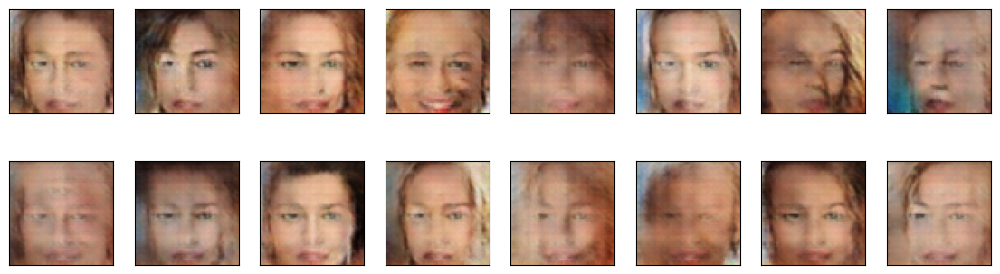

2024-01-25 00:18:36 | Epoch [7/50] | Batch 0/509 | d_loss: 1.0878 | g_loss: 1.5999
2024-01-25 00:18:39 | Epoch [7/50] | Batch 50/509 | d_loss: 1.0977 | g_loss: 1.3780
2024-01-25 00:18:42 | Epoch [7/50] | Batch 100/509 | d_loss: 1.0511 | g_loss: 1.4972
2024-01-25 00:18:45 | Epoch [7/50] | Batch 150/509 | d_loss: 1.2768 | g_loss: 0.8237
2024-01-25 00:18:48 | Epoch [7/50] | Batch 200/509 | d_loss: 1.1652 | g_loss: 1.2019
2024-01-25 00:18:51 | Epoch [7/50] | Batch 250/509 | d_loss: 1.2433 | g_loss: 1.2706
2024-01-25 00:18:54 | Epoch [7/50] | Batch 300/509 | d_loss: 1.3938 | g_loss: 1.0712
2024-01-25 00:18:57 | Epoch [7/50] | Batch 350/509 | d_loss: 1.1618 | g_loss: 1.5202
2024-01-25 00:19:00 | Epoch [7/50] | Batch 400/509 | d_loss: 1.1230 | g_loss: 1.6547
2024-01-25 00:19:03 | Epoch [7/50] | Batch 450/509 | d_loss: 1.1679 | g_loss: 1.0250
2024-01-25 00:19:05 | Epoch [7/50] | Batch 500/509 | d_loss: 1.3450 | g_loss: 1.2379


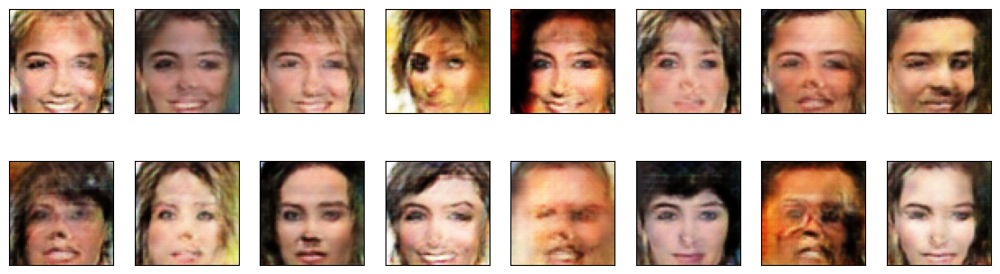

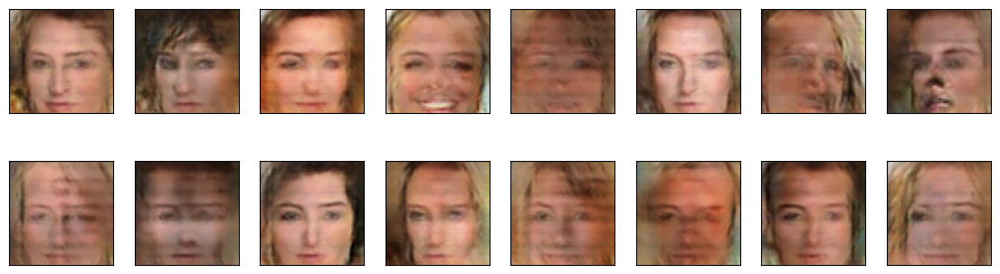

2024-01-25 00:19:07 | Epoch [8/50] | Batch 0/509 | d_loss: 1.0293 | g_loss: 1.1706
2024-01-25 00:19:10 | Epoch [8/50] | Batch 50/509 | d_loss: 1.1615 | g_loss: 1.7305
2024-01-25 00:19:13 | Epoch [8/50] | Batch 100/509 | d_loss: 1.1535 | g_loss: 1.2831
2024-01-25 00:19:16 | Epoch [8/50] | Batch 150/509 | d_loss: 1.1744 | g_loss: 0.9296
2024-01-25 00:19:19 | Epoch [8/50] | Batch 200/509 | d_loss: 1.0137 | g_loss: 1.1623
2024-01-25 00:19:22 | Epoch [8/50] | Batch 250/509 | d_loss: 1.1088 | g_loss: 1.1754
2024-01-25 00:19:25 | Epoch [8/50] | Batch 300/509 | d_loss: 1.3123 | g_loss: 1.5493
2024-01-25 00:19:28 | Epoch [8/50] | Batch 350/509 | d_loss: 1.2057 | g_loss: 1.2291
2024-01-25 00:19:31 | Epoch [8/50] | Batch 400/509 | d_loss: 1.0449 | g_loss: 1.1605
2024-01-25 00:19:34 | Epoch [8/50] | Batch 450/509 | d_loss: 1.0830 | g_loss: 1.1956
2024-01-25 00:19:37 | Epoch [8/50] | Batch 500/509 | d_loss: 1.0685 | g_loss: 1.4310


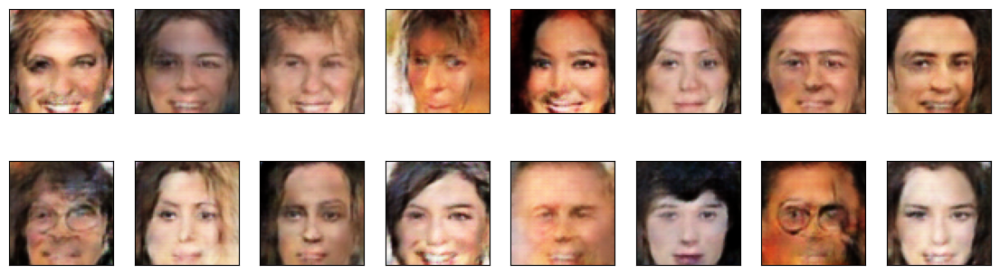

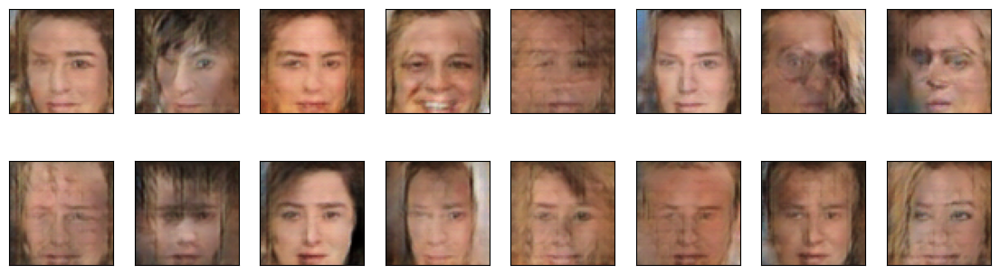

2024-01-25 00:19:39 | Epoch [9/50] | Batch 0/509 | d_loss: 1.1963 | g_loss: 1.0422
2024-01-25 00:19:42 | Epoch [9/50] | Batch 50/509 | d_loss: 1.2901 | g_loss: 0.6649
2024-01-25 00:19:44 | Epoch [9/50] | Batch 100/509 | d_loss: 1.1517 | g_loss: 1.3681
2024-01-25 00:19:47 | Epoch [9/50] | Batch 150/509 | d_loss: 1.0910 | g_loss: 1.1639
2024-01-25 00:19:50 | Epoch [9/50] | Batch 200/509 | d_loss: 1.2361 | g_loss: 0.8151
2024-01-25 00:19:53 | Epoch [9/50] | Batch 250/509 | d_loss: 1.2840 | g_loss: 0.6554
2024-01-25 00:19:56 | Epoch [9/50] | Batch 300/509 | d_loss: 1.1547 | g_loss: 1.0599
2024-01-25 00:19:59 | Epoch [9/50] | Batch 350/509 | d_loss: 1.2412 | g_loss: 0.6813
2024-01-25 00:20:02 | Epoch [9/50] | Batch 400/509 | d_loss: 1.1739 | g_loss: 1.0507
2024-01-25 00:20:05 | Epoch [9/50] | Batch 450/509 | d_loss: 1.1777 | g_loss: 1.4970
2024-01-25 00:20:08 | Epoch [9/50] | Batch 500/509 | d_loss: 1.2961 | g_loss: 1.4758


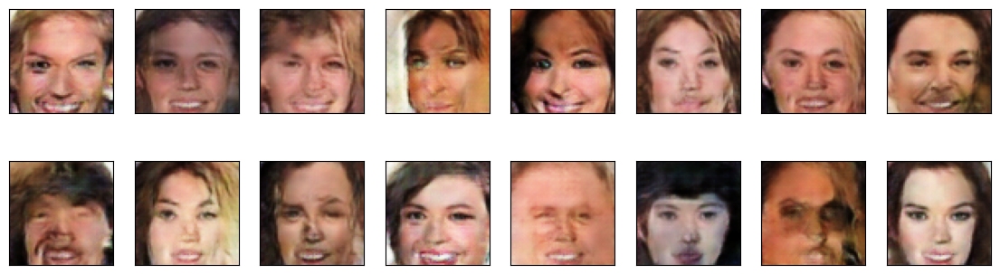

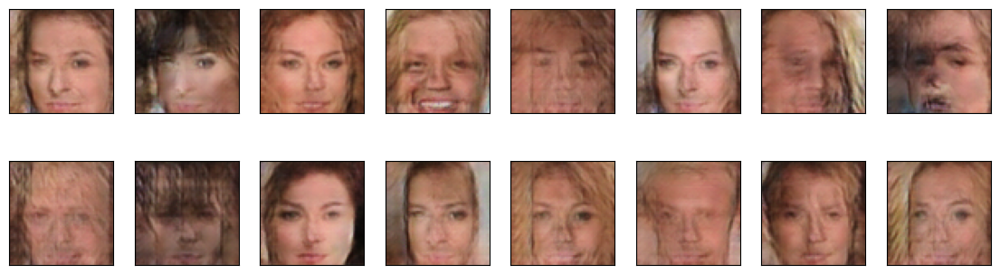

2024-01-25 00:20:10 | Epoch [10/50] | Batch 0/509 | d_loss: 1.1556 | g_loss: 1.0419
2024-01-25 00:20:13 | Epoch [10/50] | Batch 50/509 | d_loss: 1.5303 | g_loss: 2.0919
2024-01-25 00:20:16 | Epoch [10/50] | Batch 100/509 | d_loss: 1.0671 | g_loss: 1.0761
2024-01-25 00:20:18 | Epoch [10/50] | Batch 150/509 | d_loss: 1.1255 | g_loss: 1.1415
2024-01-25 00:20:21 | Epoch [10/50] | Batch 200/509 | d_loss: 1.1515 | g_loss: 1.2147
2024-01-25 00:20:24 | Epoch [10/50] | Batch 250/509 | d_loss: 1.0211 | g_loss: 1.5125
2024-01-25 00:20:27 | Epoch [10/50] | Batch 300/509 | d_loss: 1.0538 | g_loss: 1.1812
2024-01-25 00:20:30 | Epoch [10/50] | Batch 350/509 | d_loss: 1.2203 | g_loss: 1.2119
2024-01-25 00:20:33 | Epoch [10/50] | Batch 400/509 | d_loss: 1.3345 | g_loss: 1.2972
2024-01-25 00:20:36 | Epoch [10/50] | Batch 450/509 | d_loss: 1.2638 | g_loss: 0.6192
2024-01-25 00:20:39 | Epoch [10/50] | Batch 500/509 | d_loss: 1.1100 | g_loss: 1.0785


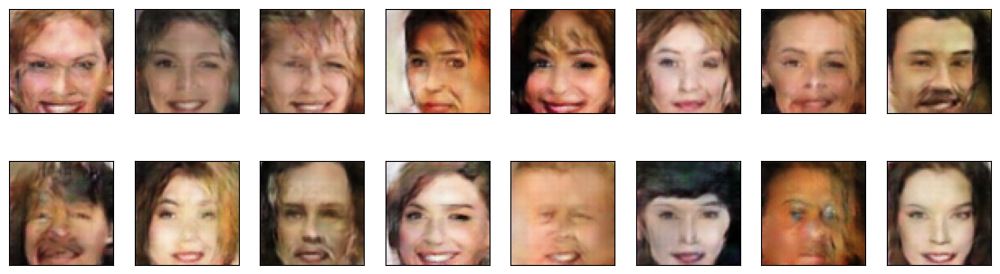

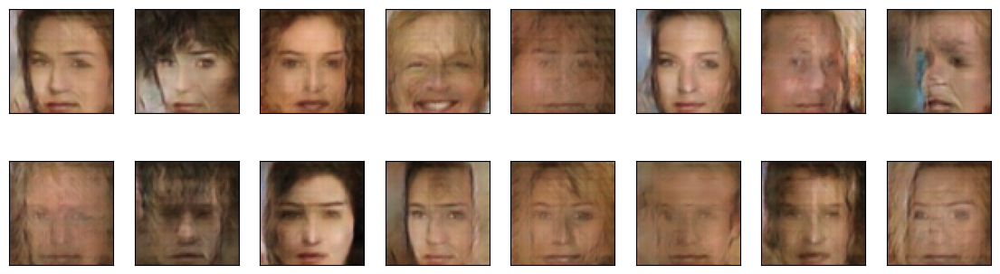

2024-01-25 00:20:41 | Epoch [11/50] | Batch 0/509 | d_loss: 1.1819 | g_loss: 1.2329
2024-01-25 00:20:44 | Epoch [11/50] | Batch 50/509 | d_loss: 1.1842 | g_loss: 1.3397
2024-01-25 00:20:47 | Epoch [11/50] | Batch 100/509 | d_loss: 1.3447 | g_loss: 0.8850
2024-01-25 00:20:50 | Epoch [11/50] | Batch 150/509 | d_loss: 1.1372 | g_loss: 0.6936
2024-01-25 00:20:52 | Epoch [11/50] | Batch 200/509 | d_loss: 1.0828 | g_loss: 1.4312
2024-01-25 00:20:55 | Epoch [11/50] | Batch 250/509 | d_loss: 1.2569 | g_loss: 0.7900
2024-01-25 00:20:58 | Epoch [11/50] | Batch 300/509 | d_loss: 1.0587 | g_loss: 0.6788
2024-01-25 00:21:01 | Epoch [11/50] | Batch 350/509 | d_loss: 1.0475 | g_loss: 1.4676
2024-01-25 00:21:04 | Epoch [11/50] | Batch 400/509 | d_loss: 1.1078 | g_loss: 1.0215
2024-01-25 00:21:07 | Epoch [11/50] | Batch 450/509 | d_loss: 1.2148 | g_loss: 1.0355
2024-01-25 00:21:10 | Epoch [11/50] | Batch 500/509 | d_loss: 1.1711 | g_loss: 0.8380


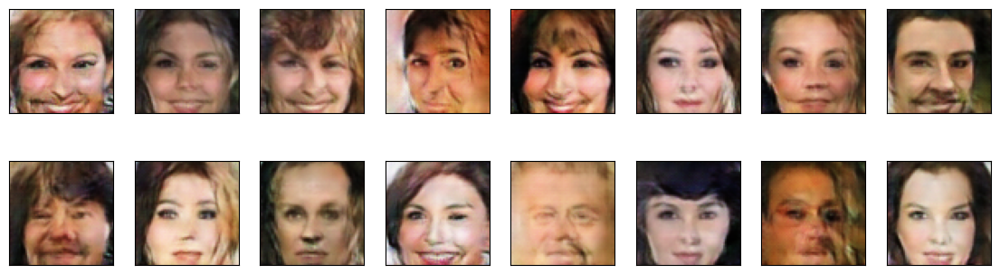

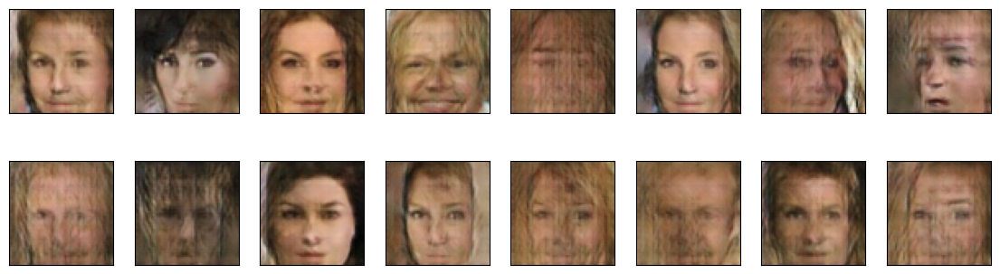

2024-01-25 00:21:12 | Epoch [12/50] | Batch 0/509 | d_loss: 1.6553 | g_loss: 0.5154
2024-01-25 00:21:15 | Epoch [12/50] | Batch 50/509 | d_loss: 1.2172 | g_loss: 0.5914
2024-01-25 00:21:18 | Epoch [12/50] | Batch 100/509 | d_loss: 1.0523 | g_loss: 1.2052
2024-01-25 00:21:21 | Epoch [12/50] | Batch 150/509 | d_loss: 1.0163 | g_loss: 1.2191
2024-01-25 00:21:24 | Epoch [12/50] | Batch 200/509 | d_loss: 1.1350 | g_loss: 1.3620
2024-01-25 00:21:27 | Epoch [12/50] | Batch 250/509 | d_loss: 1.3524 | g_loss: 1.9565
2024-01-25 00:21:29 | Epoch [12/50] | Batch 300/509 | d_loss: 1.0897 | g_loss: 1.0821
2024-01-25 00:21:32 | Epoch [12/50] | Batch 350/509 | d_loss: 1.2677 | g_loss: 1.6752
2024-01-25 00:21:35 | Epoch [12/50] | Batch 400/509 | d_loss: 1.0959 | g_loss: 0.9544
2024-01-25 00:21:38 | Epoch [12/50] | Batch 450/509 | d_loss: 1.1468 | g_loss: 0.9932
2024-01-25 00:21:41 | Epoch [12/50] | Batch 500/509 | d_loss: 1.0634 | g_loss: 0.7549


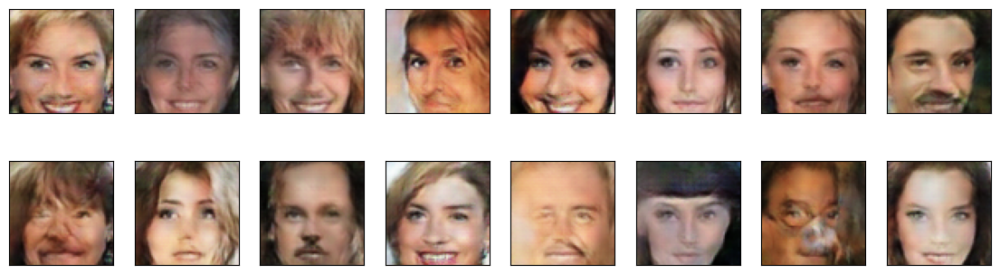

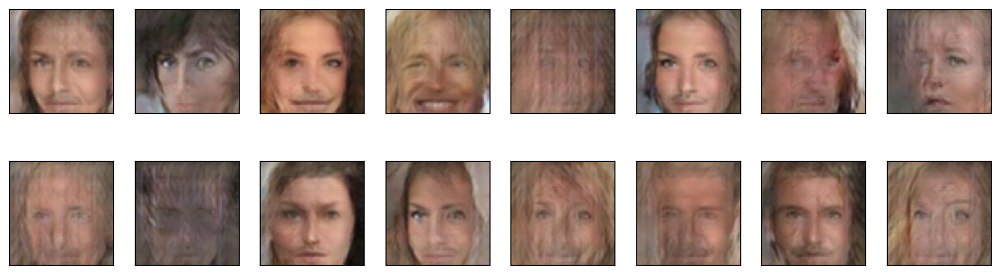

2024-01-25 00:21:43 | Epoch [13/50] | Batch 0/509 | d_loss: 1.0674 | g_loss: 1.6793
2024-01-25 00:21:46 | Epoch [13/50] | Batch 50/509 | d_loss: 1.3827 | g_loss: 0.5447
2024-01-25 00:21:49 | Epoch [13/50] | Batch 100/509 | d_loss: 1.0662 | g_loss: 1.4110
2024-01-25 00:21:52 | Epoch [13/50] | Batch 150/509 | d_loss: 2.1878 | g_loss: 2.3559
2024-01-25 00:21:55 | Epoch [13/50] | Batch 200/509 | d_loss: 1.2973 | g_loss: 1.5973
2024-01-25 00:21:58 | Epoch [13/50] | Batch 250/509 | d_loss: 1.1087 | g_loss: 1.3236
2024-01-25 00:22:01 | Epoch [13/50] | Batch 300/509 | d_loss: 1.3502 | g_loss: 1.8240
2024-01-25 00:22:04 | Epoch [13/50] | Batch 350/509 | d_loss: 1.0503 | g_loss: 1.1483
2024-01-25 00:22:07 | Epoch [13/50] | Batch 400/509 | d_loss: 0.9681 | g_loss: 1.3741
2024-01-25 00:22:09 | Epoch [13/50] | Batch 450/509 | d_loss: 1.0658 | g_loss: 1.0828
2024-01-25 00:22:12 | Epoch [13/50] | Batch 500/509 | d_loss: 1.0150 | g_loss: 1.3404


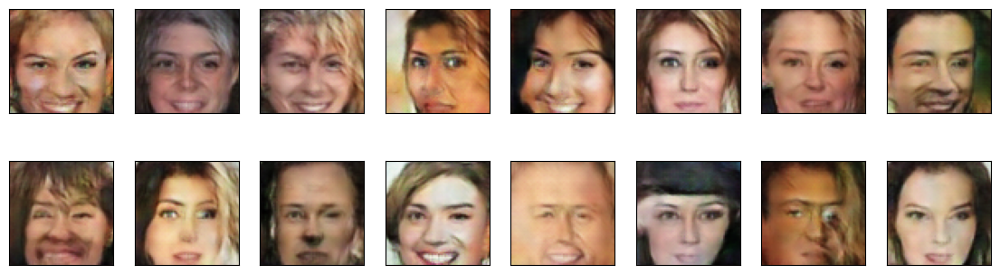

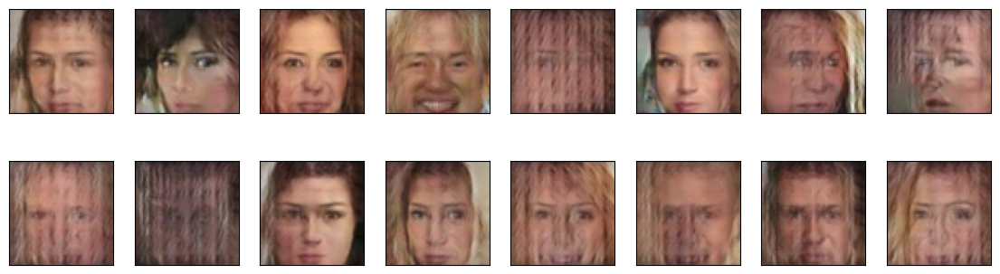

2024-01-25 00:22:14 | Epoch [14/50] | Batch 0/509 | d_loss: 1.0782 | g_loss: 1.2340
2024-01-25 00:22:17 | Epoch [14/50] | Batch 50/509 | d_loss: 1.0070 | g_loss: 1.3019
2024-01-25 00:22:20 | Epoch [14/50] | Batch 100/509 | d_loss: 1.1389 | g_loss: 0.7062
2024-01-25 00:22:23 | Epoch [14/50] | Batch 150/509 | d_loss: 1.2396 | g_loss: 0.8025
2024-01-25 00:22:26 | Epoch [14/50] | Batch 200/509 | d_loss: 1.1372 | g_loss: 1.0289
2024-01-25 00:22:29 | Epoch [14/50] | Batch 250/509 | d_loss: 1.1019 | g_loss: 0.7848
2024-01-25 00:22:32 | Epoch [14/50] | Batch 300/509 | d_loss: 1.2004 | g_loss: 1.6083
2024-01-25 00:22:35 | Epoch [14/50] | Batch 350/509 | d_loss: 1.1964 | g_loss: 0.6429
2024-01-25 00:22:38 | Epoch [14/50] | Batch 400/509 | d_loss: 1.1102 | g_loss: 1.0290
2024-01-25 00:22:40 | Epoch [14/50] | Batch 450/509 | d_loss: 1.1690 | g_loss: 0.9867
2024-01-25 00:22:43 | Epoch [14/50] | Batch 500/509 | d_loss: 1.1784 | g_loss: 1.3131


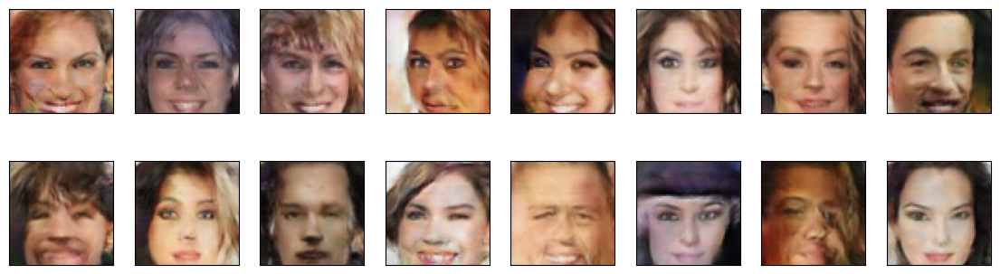

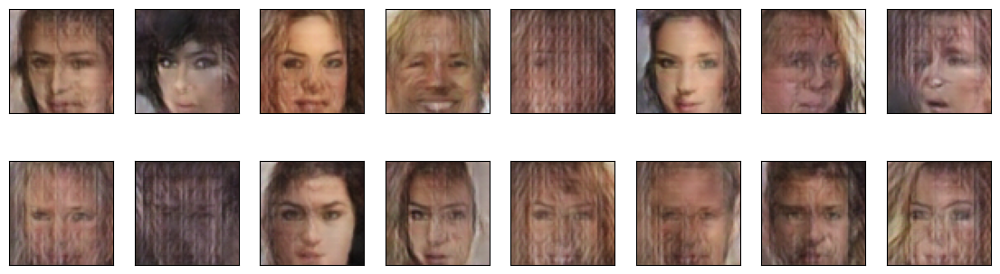

2024-01-25 00:22:45 | Epoch [15/50] | Batch 0/509 | d_loss: 1.1033 | g_loss: 1.0471
2024-01-25 00:22:48 | Epoch [15/50] | Batch 50/509 | d_loss: 1.2215 | g_loss: 0.6845
2024-01-25 00:22:51 | Epoch [15/50] | Batch 100/509 | d_loss: 1.0473 | g_loss: 0.9131
2024-01-25 00:22:54 | Epoch [15/50] | Batch 150/509 | d_loss: 1.0830 | g_loss: 1.2418
2024-01-25 00:22:57 | Epoch [15/50] | Batch 200/509 | d_loss: 1.0232 | g_loss: 1.4961
2024-01-25 00:23:00 | Epoch [15/50] | Batch 250/509 | d_loss: 1.1760 | g_loss: 0.9896
2024-01-25 00:23:03 | Epoch [15/50] | Batch 300/509 | d_loss: 1.1233 | g_loss: 1.4777
2024-01-25 00:23:06 | Epoch [15/50] | Batch 350/509 | d_loss: 0.9612 | g_loss: 1.0725
2024-01-25 00:23:09 | Epoch [15/50] | Batch 400/509 | d_loss: 1.0160 | g_loss: 1.8945
2024-01-25 00:23:12 | Epoch [15/50] | Batch 450/509 | d_loss: 1.1340 | g_loss: 1.2090
2024-01-25 00:23:15 | Epoch [15/50] | Batch 500/509 | d_loss: 1.0221 | g_loss: 1.2615


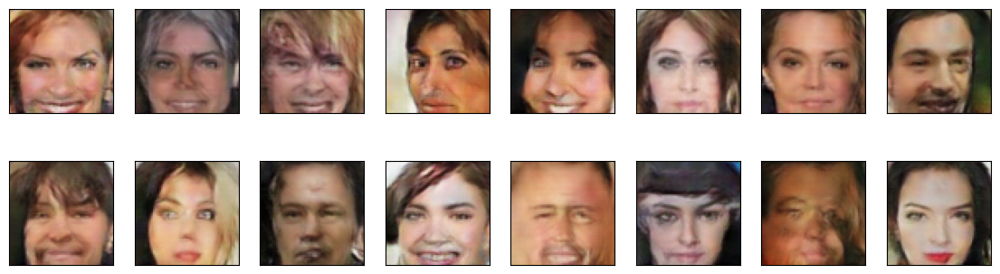

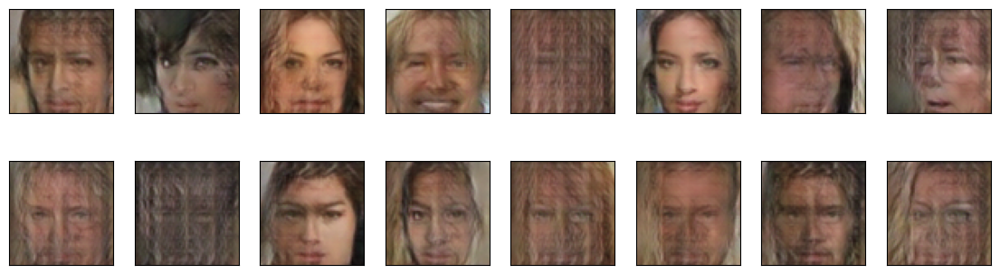

2024-01-25 00:23:17 | Epoch [16/50] | Batch 0/509 | d_loss: 0.9924 | g_loss: 1.1442
2024-01-25 00:23:20 | Epoch [16/50] | Batch 50/509 | d_loss: 1.0746 | g_loss: 1.0481
2024-01-25 00:23:22 | Epoch [16/50] | Batch 100/509 | d_loss: 1.0451 | g_loss: 1.3515
2024-01-25 00:23:25 | Epoch [16/50] | Batch 150/509 | d_loss: 1.1617 | g_loss: 0.5764
2024-01-25 00:23:28 | Epoch [16/50] | Batch 200/509 | d_loss: 0.9961 | g_loss: 1.1218
2024-01-25 00:23:31 | Epoch [16/50] | Batch 250/509 | d_loss: 1.0657 | g_loss: 1.0881
2024-01-25 00:23:34 | Epoch [16/50] | Batch 300/509 | d_loss: 1.0577 | g_loss: 0.7262
2024-01-25 00:23:37 | Epoch [16/50] | Batch 350/509 | d_loss: 0.9531 | g_loss: 1.1634
2024-01-25 00:23:40 | Epoch [16/50] | Batch 400/509 | d_loss: 1.0479 | g_loss: 1.1451
2024-01-25 00:23:43 | Epoch [16/50] | Batch 450/509 | d_loss: 1.1186 | g_loss: 1.3329
2024-01-25 00:23:46 | Epoch [16/50] | Batch 500/509 | d_loss: 0.9904 | g_loss: 1.3144


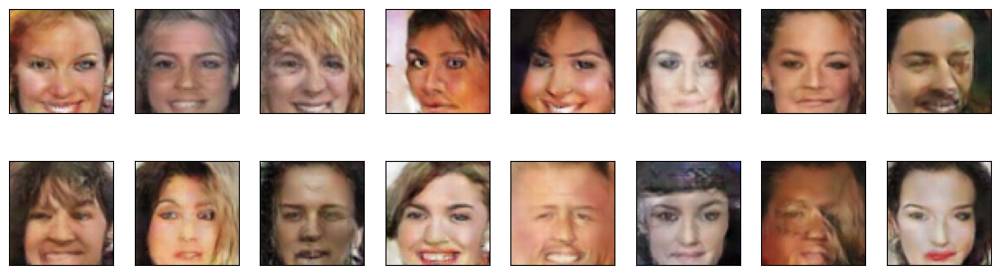

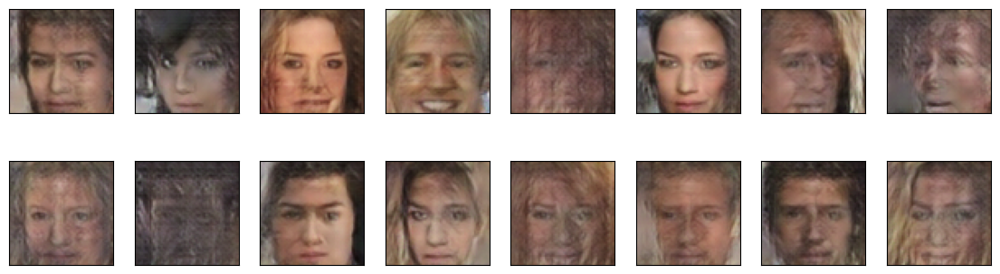

2024-01-25 00:23:48 | Epoch [17/50] | Batch 0/509 | d_loss: 1.3317 | g_loss: 0.5939
2024-01-25 00:23:51 | Epoch [17/50] | Batch 50/509 | d_loss: 0.8819 | g_loss: 1.2686
2024-01-25 00:23:54 | Epoch [17/50] | Batch 100/509 | d_loss: 1.0761 | g_loss: 1.0783
2024-01-25 00:23:56 | Epoch [17/50] | Batch 150/509 | d_loss: 1.1712 | g_loss: 1.8802
2024-01-25 00:23:59 | Epoch [17/50] | Batch 200/509 | d_loss: 0.9378 | g_loss: 1.2095
2024-01-25 00:24:02 | Epoch [17/50] | Batch 250/509 | d_loss: 0.9960 | g_loss: 1.2778
2024-01-25 00:24:05 | Epoch [17/50] | Batch 300/509 | d_loss: 0.9270 | g_loss: 1.6984
2024-01-25 00:24:08 | Epoch [17/50] | Batch 350/509 | d_loss: 1.1241 | g_loss: 1.5610
2024-01-25 00:24:11 | Epoch [17/50] | Batch 400/509 | d_loss: 1.0040 | g_loss: 1.5117
2024-01-25 00:24:14 | Epoch [17/50] | Batch 450/509 | d_loss: 0.8532 | g_loss: 1.5572
2024-01-25 00:24:17 | Epoch [17/50] | Batch 500/509 | d_loss: 0.9606 | g_loss: 1.4990


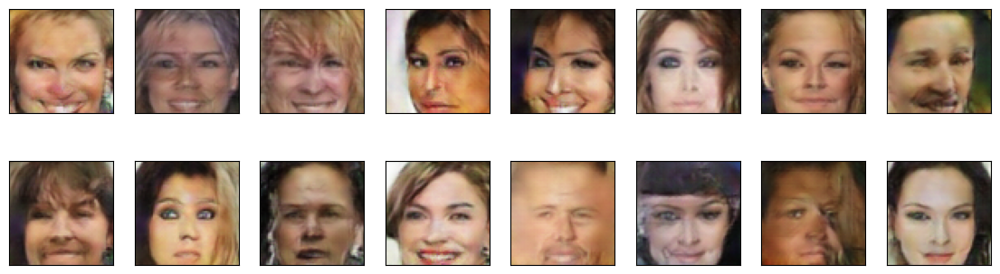

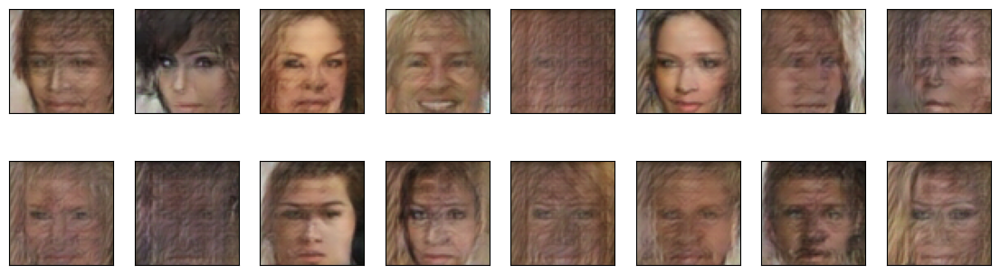

2024-01-25 00:24:19 | Epoch [18/50] | Batch 0/509 | d_loss: 0.9284 | g_loss: 1.8972
2024-01-25 00:24:22 | Epoch [18/50] | Batch 50/509 | d_loss: 1.0434 | g_loss: 0.8756
2024-01-25 00:24:25 | Epoch [18/50] | Batch 100/509 | d_loss: 0.9069 | g_loss: 1.1529
2024-01-25 00:24:28 | Epoch [18/50] | Batch 150/509 | d_loss: 1.2110 | g_loss: 0.6959
2024-01-25 00:24:30 | Epoch [18/50] | Batch 200/509 | d_loss: 1.0404 | g_loss: 1.9856
2024-01-25 00:24:33 | Epoch [18/50] | Batch 250/509 | d_loss: 0.9066 | g_loss: 1.2175
2024-01-25 00:24:36 | Epoch [18/50] | Batch 300/509 | d_loss: 1.4036 | g_loss: 0.5305
2024-01-25 00:24:39 | Epoch [18/50] | Batch 350/509 | d_loss: 1.0621 | g_loss: 2.0883
2024-01-25 00:24:42 | Epoch [18/50] | Batch 400/509 | d_loss: 1.1139 | g_loss: 1.4711
2024-01-25 00:24:45 | Epoch [18/50] | Batch 450/509 | d_loss: 0.9047 | g_loss: 1.3991
2024-01-25 00:24:48 | Epoch [18/50] | Batch 500/509 | d_loss: 0.8895 | g_loss: 1.0657


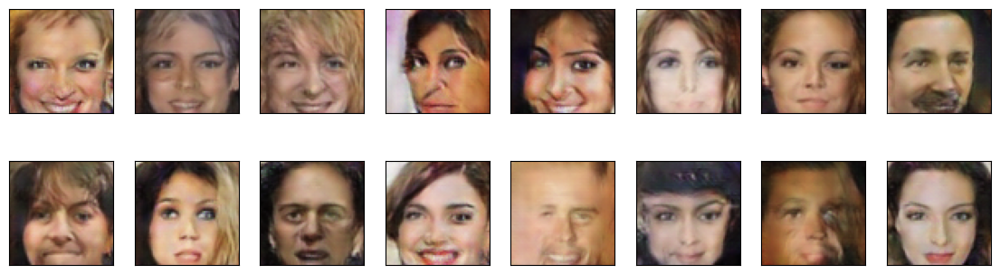

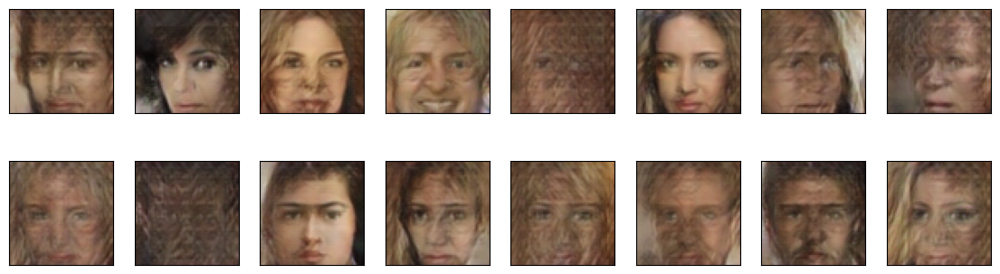

2024-01-25 00:24:50 | Epoch [19/50] | Batch 0/509 | d_loss: 1.3850 | g_loss: 0.6598
2024-01-25 00:24:53 | Epoch [19/50] | Batch 50/509 | d_loss: 1.2955 | g_loss: 0.8198
2024-01-25 00:24:56 | Epoch [19/50] | Batch 100/509 | d_loss: 0.9954 | g_loss: 1.1901
2024-01-25 00:24:59 | Epoch [19/50] | Batch 150/509 | d_loss: 0.7990 | g_loss: 1.5500
2024-01-25 00:25:02 | Epoch [19/50] | Batch 200/509 | d_loss: 0.9133 | g_loss: 1.5449
2024-01-25 00:25:05 | Epoch [19/50] | Batch 250/509 | d_loss: 0.8839 | g_loss: 1.1566
2024-01-25 00:25:07 | Epoch [19/50] | Batch 300/509 | d_loss: 0.8381 | g_loss: 0.9661
2024-01-25 00:25:10 | Epoch [19/50] | Batch 350/509 | d_loss: 0.7849 | g_loss: 1.2966
2024-01-25 00:25:13 | Epoch [19/50] | Batch 400/509 | d_loss: 0.9078 | g_loss: 1.9856
2024-01-25 00:25:16 | Epoch [19/50] | Batch 450/509 | d_loss: 1.0496 | g_loss: 2.1969
2024-01-25 00:25:19 | Epoch [19/50] | Batch 500/509 | d_loss: 0.8651 | g_loss: 1.4031


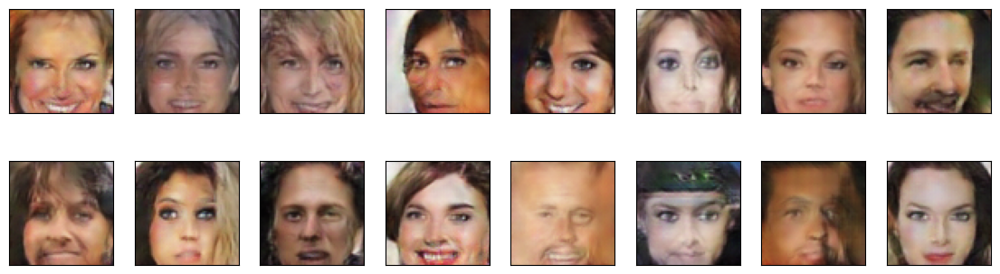

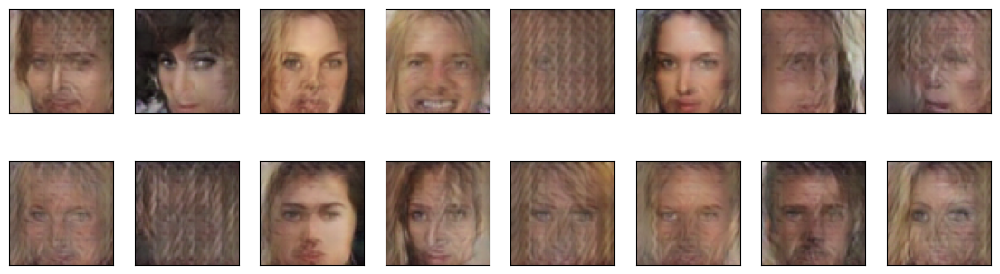

2024-01-25 00:25:21 | Epoch [20/50] | Batch 0/509 | d_loss: 0.8317 | g_loss: 1.4331
2024-01-25 00:25:24 | Epoch [20/50] | Batch 50/509 | d_loss: 0.8112 | g_loss: 1.4031
2024-01-25 00:25:27 | Epoch [20/50] | Batch 100/509 | d_loss: 0.8399 | g_loss: 1.0690
2024-01-25 00:25:30 | Epoch [20/50] | Batch 150/509 | d_loss: 0.9186 | g_loss: 1.1470
2024-01-25 00:25:33 | Epoch [20/50] | Batch 200/509 | d_loss: 1.0901 | g_loss: 0.8763
2024-01-25 00:25:36 | Epoch [20/50] | Batch 250/509 | d_loss: 0.9465 | g_loss: 2.2466
2024-01-25 00:25:39 | Epoch [20/50] | Batch 300/509 | d_loss: 0.7504 | g_loss: 1.5523
2024-01-25 00:25:42 | Epoch [20/50] | Batch 350/509 | d_loss: 0.8312 | g_loss: 1.3661
2024-01-25 00:25:44 | Epoch [20/50] | Batch 400/509 | d_loss: 1.0272 | g_loss: 2.2188
2024-01-25 00:25:47 | Epoch [20/50] | Batch 450/509 | d_loss: 0.9660 | g_loss: 1.9359
2024-01-25 00:25:50 | Epoch [20/50] | Batch 500/509 | d_loss: 0.9570 | g_loss: 2.2641


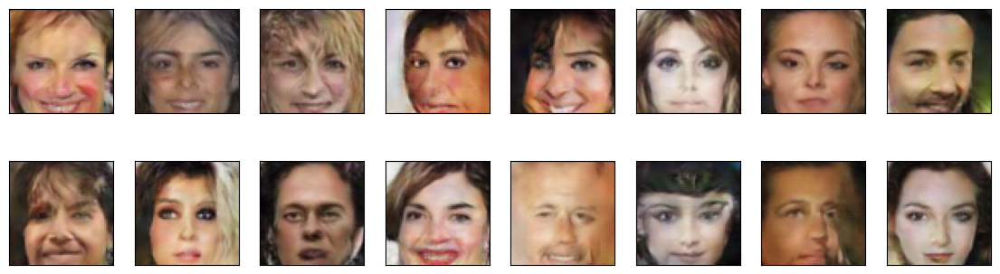

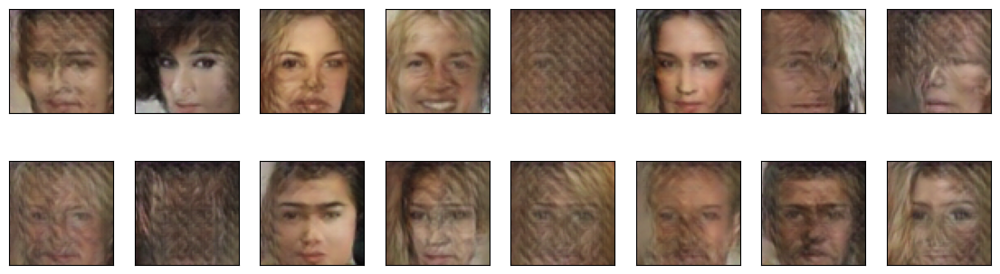

2024-01-25 00:25:52 | Epoch [21/50] | Batch 0/509 | d_loss: 0.8750 | g_loss: 1.6351
2024-01-25 00:25:55 | Epoch [21/50] | Batch 50/509 | d_loss: 0.7273 | g_loss: 1.5205
2024-01-25 00:25:58 | Epoch [21/50] | Batch 100/509 | d_loss: 0.9119 | g_loss: 2.1022
2024-01-25 00:26:01 | Epoch [21/50] | Batch 150/509 | d_loss: 0.7348 | g_loss: 2.0580
2024-01-25 00:26:04 | Epoch [21/50] | Batch 200/509 | d_loss: 1.0635 | g_loss: 2.5706
2024-01-25 00:26:07 | Epoch [21/50] | Batch 250/509 | d_loss: 0.7999 | g_loss: 2.5219
2024-01-25 00:26:10 | Epoch [21/50] | Batch 300/509 | d_loss: 0.8425 | g_loss: 1.6126
2024-01-25 00:26:13 | Epoch [21/50] | Batch 350/509 | d_loss: 0.8810 | g_loss: 1.3554
2024-01-25 00:26:15 | Epoch [21/50] | Batch 400/509 | d_loss: 0.8072 | g_loss: 1.0119
2024-01-25 00:26:18 | Epoch [21/50] | Batch 450/509 | d_loss: 0.7999 | g_loss: 1.5263
2024-01-25 00:26:21 | Epoch [21/50] | Batch 500/509 | d_loss: 0.7359 | g_loss: 1.7657


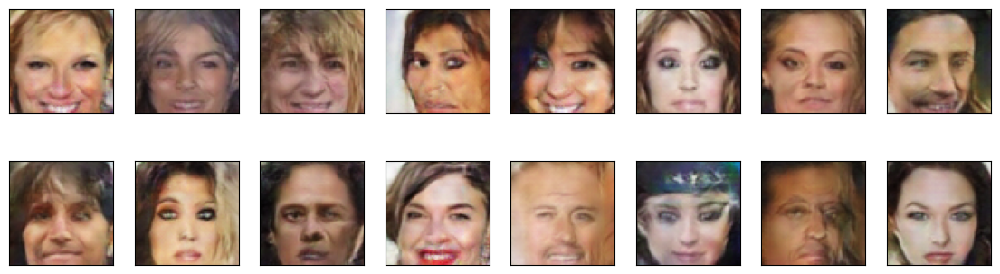

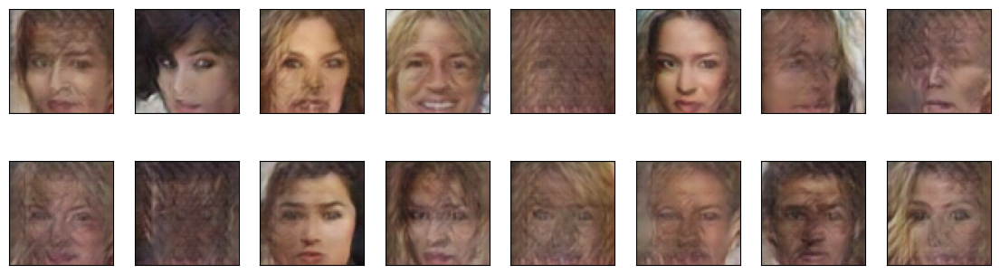

2024-01-25 00:26:23 | Epoch [22/50] | Batch 0/509 | d_loss: 1.1558 | g_loss: 0.7836
2024-01-25 00:26:26 | Epoch [22/50] | Batch 50/509 | d_loss: 0.7869 | g_loss: 1.0619
2024-01-25 00:26:29 | Epoch [22/50] | Batch 100/509 | d_loss: 0.8370 | g_loss: 1.5344
2024-01-25 00:26:32 | Epoch [22/50] | Batch 150/509 | d_loss: 0.8082 | g_loss: 2.4764
2024-01-25 00:26:35 | Epoch [22/50] | Batch 200/509 | d_loss: 0.7958 | g_loss: 1.0850
2024-01-25 00:26:38 | Epoch [22/50] | Batch 250/509 | d_loss: 0.8928 | g_loss: 1.6622
2024-01-25 00:26:41 | Epoch [22/50] | Batch 300/509 | d_loss: 1.0559 | g_loss: 1.1541
2024-01-25 00:26:44 | Epoch [22/50] | Batch 350/509 | d_loss: 0.7584 | g_loss: 2.3720
2024-01-25 00:26:47 | Epoch [22/50] | Batch 400/509 | d_loss: 0.8153 | g_loss: 1.3646
2024-01-25 00:26:50 | Epoch [22/50] | Batch 450/509 | d_loss: 0.9245 | g_loss: 2.0179
2024-01-25 00:26:52 | Epoch [22/50] | Batch 500/509 | d_loss: 0.7383 | g_loss: 2.2085


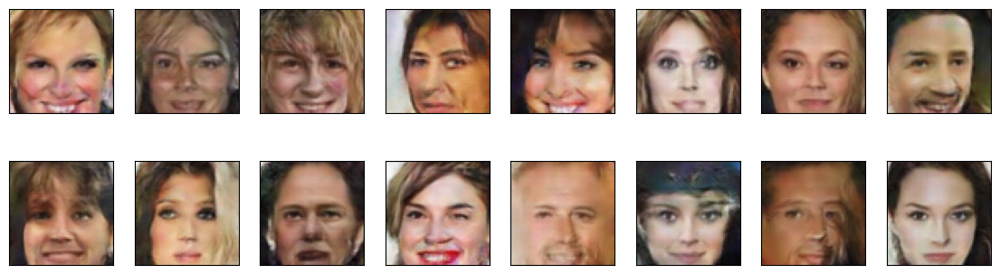

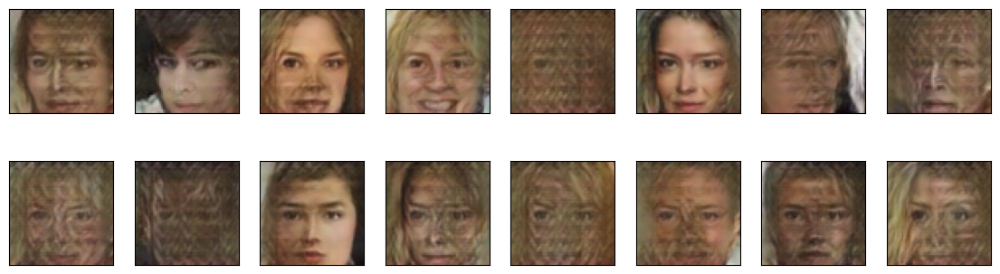

2024-01-25 00:26:54 | Epoch [23/50] | Batch 0/509 | d_loss: 0.7699 | g_loss: 1.7538
2024-01-25 00:26:57 | Epoch [23/50] | Batch 50/509 | d_loss: 0.7438 | g_loss: 1.5747
2024-01-25 00:27:00 | Epoch [23/50] | Batch 100/509 | d_loss: 0.7974 | g_loss: 2.6183
2024-01-25 00:27:03 | Epoch [23/50] | Batch 150/509 | d_loss: 0.6897 | g_loss: 1.5680
2024-01-25 00:27:06 | Epoch [23/50] | Batch 200/509 | d_loss: 0.7475 | g_loss: 2.0860
2024-01-25 00:27:09 | Epoch [23/50] | Batch 250/509 | d_loss: 1.0622 | g_loss: 0.5199
2024-01-25 00:27:12 | Epoch [23/50] | Batch 300/509 | d_loss: 0.9131 | g_loss: 2.8849
2024-01-25 00:27:15 | Epoch [23/50] | Batch 350/509 | d_loss: 0.7411 | g_loss: 1.5707
2024-01-25 00:27:18 | Epoch [23/50] | Batch 400/509 | d_loss: 0.8175 | g_loss: 1.7257
2024-01-25 00:27:21 | Epoch [23/50] | Batch 450/509 | d_loss: 1.2251 | g_loss: 1.0927
2024-01-25 00:27:24 | Epoch [23/50] | Batch 500/509 | d_loss: 1.0357 | g_loss: 0.8048


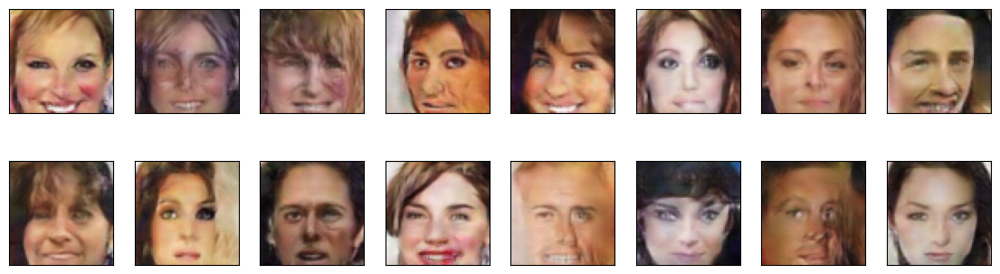

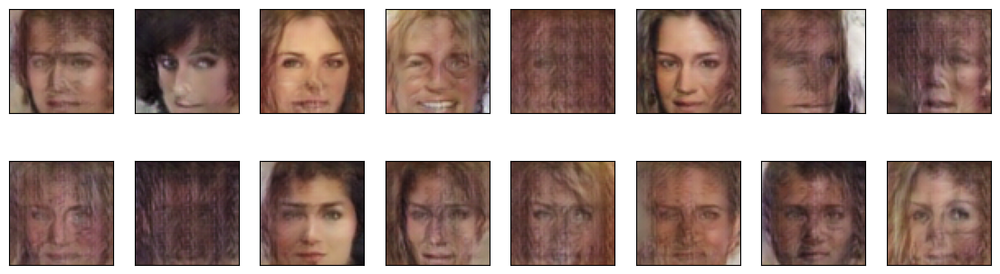

2024-01-25 00:27:26 | Epoch [24/50] | Batch 0/509 | d_loss: 0.7595 | g_loss: 1.6203
2024-01-25 00:27:29 | Epoch [24/50] | Batch 50/509 | d_loss: 0.7344 | g_loss: 1.5685
2024-01-25 00:27:31 | Epoch [24/50] | Batch 100/509 | d_loss: 0.9231 | g_loss: 1.2999
2024-01-25 00:27:34 | Epoch [24/50] | Batch 150/509 | d_loss: 1.0492 | g_loss: 0.7868
2024-01-25 00:27:37 | Epoch [24/50] | Batch 200/509 | d_loss: 1.2950 | g_loss: 0.7390
2024-01-25 00:27:40 | Epoch [24/50] | Batch 250/509 | d_loss: 0.7989 | g_loss: 1.9526
2024-01-25 00:27:43 | Epoch [24/50] | Batch 300/509 | d_loss: 0.6876 | g_loss: 1.5309
2024-01-25 00:27:46 | Epoch [24/50] | Batch 350/509 | d_loss: 0.8062 | g_loss: 1.4808
2024-01-25 00:27:49 | Epoch [24/50] | Batch 400/509 | d_loss: 1.0096 | g_loss: 0.7338
2024-01-25 00:27:52 | Epoch [24/50] | Batch 450/509 | d_loss: 2.1461 | g_loss: 0.8448
2024-01-25 00:27:55 | Epoch [24/50] | Batch 500/509 | d_loss: 1.3751 | g_loss: 0.7143


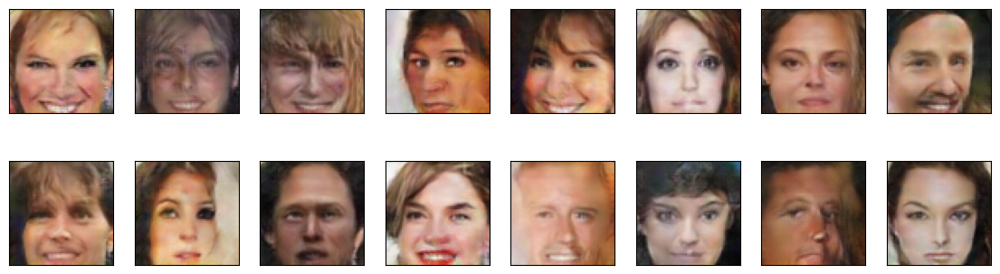

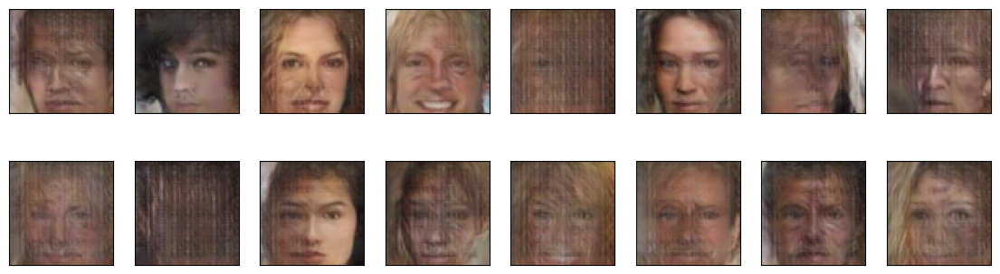

2024-01-25 00:27:57 | Epoch [25/50] | Batch 0/509 | d_loss: 0.7514 | g_loss: 1.7388
2024-01-25 00:28:00 | Epoch [25/50] | Batch 50/509 | d_loss: 0.7307 | g_loss: 1.7022
2024-01-25 00:28:03 | Epoch [25/50] | Batch 100/509 | d_loss: 0.7222 | g_loss: 1.3641
2024-01-25 00:28:06 | Epoch [25/50] | Batch 150/509 | d_loss: 0.7295 | g_loss: 2.0251
2024-01-25 00:28:08 | Epoch [25/50] | Batch 200/509 | d_loss: 0.6612 | g_loss: 1.8585
2024-01-25 00:28:11 | Epoch [25/50] | Batch 250/509 | d_loss: 0.7133 | g_loss: 1.3124
2024-01-25 00:28:14 | Epoch [25/50] | Batch 300/509 | d_loss: 0.8034 | g_loss: 1.2815
2024-01-25 00:28:17 | Epoch [25/50] | Batch 350/509 | d_loss: 0.6504 | g_loss: 1.1195
2024-01-25 00:28:20 | Epoch [25/50] | Batch 400/509 | d_loss: 0.6772 | g_loss: 2.0400
2024-01-25 00:28:23 | Epoch [25/50] | Batch 450/509 | d_loss: 0.9138 | g_loss: 2.5436
2024-01-25 00:28:26 | Epoch [25/50] | Batch 500/509 | d_loss: 0.8952 | g_loss: 2.4405


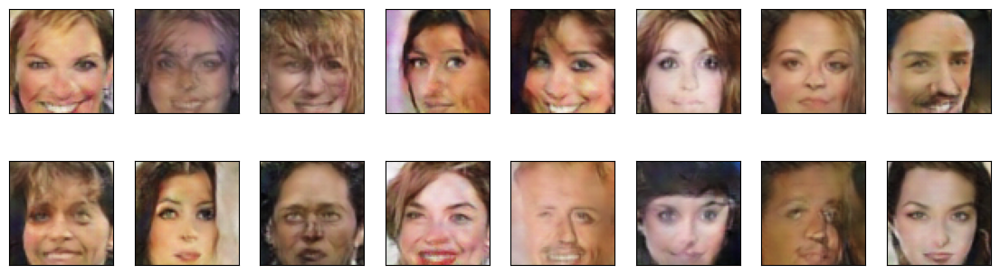

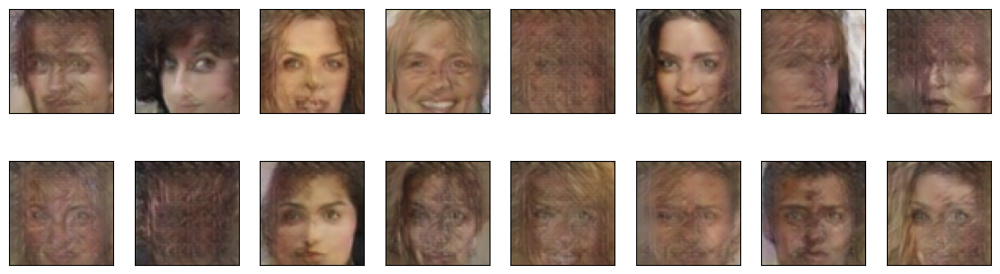

2024-01-25 00:28:28 | Epoch [26/50] | Batch 0/509 | d_loss: 0.7614 | g_loss: 1.8518
2024-01-25 00:28:31 | Epoch [26/50] | Batch 50/509 | d_loss: 0.7254 | g_loss: 1.7285
2024-01-25 00:28:34 | Epoch [26/50] | Batch 100/509 | d_loss: 0.5852 | g_loss: 1.2800
2024-01-25 00:28:37 | Epoch [26/50] | Batch 150/509 | d_loss: 0.8198 | g_loss: 2.3341
2024-01-25 00:28:40 | Epoch [26/50] | Batch 200/509 | d_loss: 1.2725 | g_loss: 2.5033
2024-01-25 00:28:42 | Epoch [26/50] | Batch 250/509 | d_loss: 0.9467 | g_loss: 0.9437
2024-01-25 00:28:45 | Epoch [26/50] | Batch 300/509 | d_loss: 0.8464 | g_loss: 2.9753
2024-01-25 00:28:48 | Epoch [26/50] | Batch 350/509 | d_loss: 0.9585 | g_loss: 1.7718
2024-01-25 00:28:51 | Epoch [26/50] | Batch 400/509 | d_loss: 0.7944 | g_loss: 2.5587
2024-01-25 00:28:54 | Epoch [26/50] | Batch 450/509 | d_loss: 1.1559 | g_loss: 0.6491
2024-01-25 00:28:57 | Epoch [26/50] | Batch 500/509 | d_loss: 0.8785 | g_loss: 1.1735


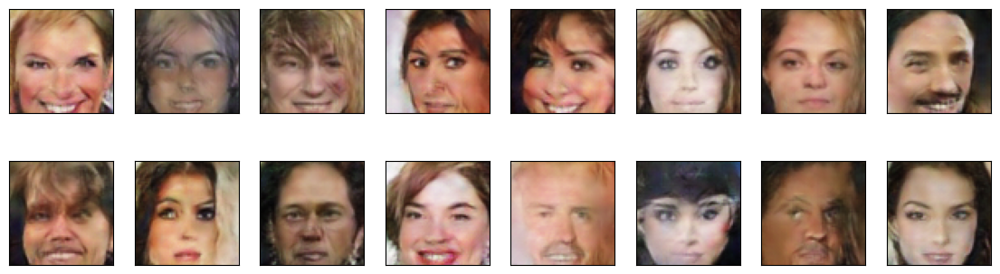

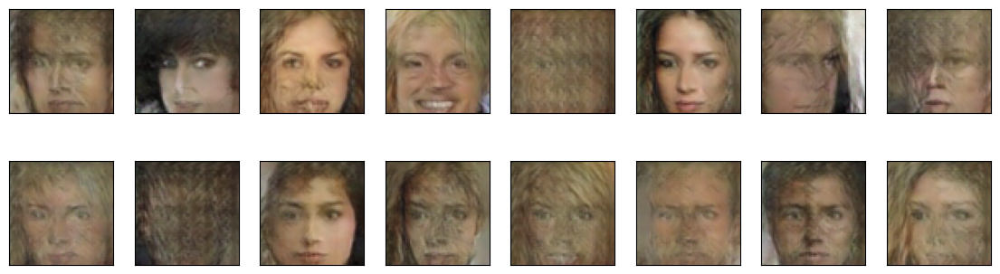

2024-01-25 00:28:59 | Epoch [27/50] | Batch 0/509 | d_loss: 0.6536 | g_loss: 1.3550
2024-01-25 00:29:02 | Epoch [27/50] | Batch 50/509 | d_loss: 0.8328 | g_loss: 1.6933
2024-01-25 00:29:05 | Epoch [27/50] | Batch 100/509 | d_loss: 1.5733 | g_loss: 2.9123
2024-01-25 00:29:08 | Epoch [27/50] | Batch 150/509 | d_loss: 0.6967 | g_loss: 1.3273
2024-01-25 00:29:11 | Epoch [27/50] | Batch 200/509 | d_loss: 1.1341 | g_loss: 1.3716
2024-01-25 00:29:14 | Epoch [27/50] | Batch 250/509 | d_loss: 0.6644 | g_loss: 1.6298
2024-01-25 00:29:17 | Epoch [27/50] | Batch 300/509 | d_loss: 0.8968 | g_loss: 2.4376
2024-01-25 00:29:19 | Epoch [27/50] | Batch 350/509 | d_loss: 0.7652 | g_loss: 1.8934
2024-01-25 00:29:22 | Epoch [27/50] | Batch 400/509 | d_loss: 0.7528 | g_loss: 1.5105
2024-01-25 00:29:25 | Epoch [27/50] | Batch 450/509 | d_loss: 0.6980 | g_loss: 1.5769
2024-01-25 00:29:28 | Epoch [27/50] | Batch 500/509 | d_loss: 1.3019 | g_loss: 3.4247


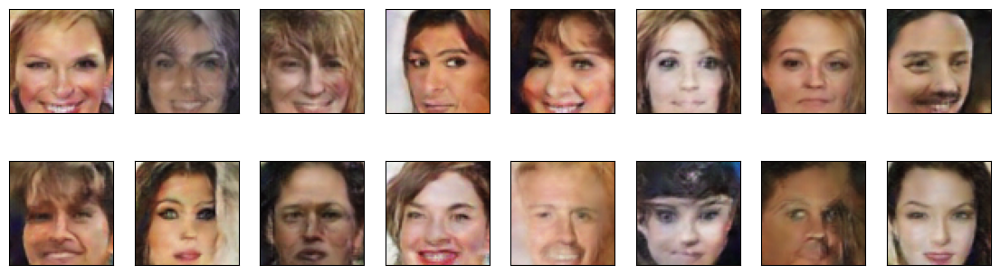

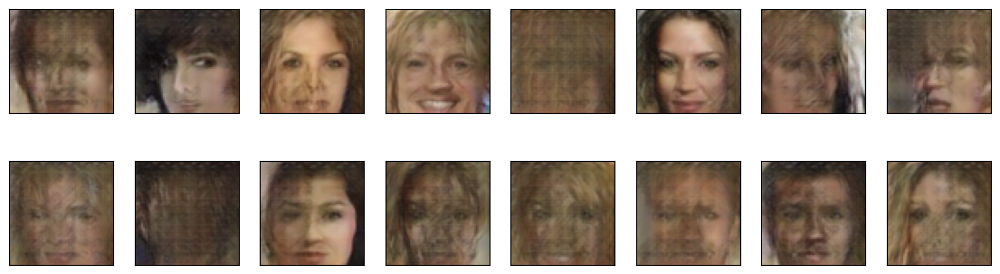

2024-01-25 00:29:30 | Epoch [28/50] | Batch 0/509 | d_loss: 0.7319 | g_loss: 1.9248
2024-01-25 00:29:33 | Epoch [28/50] | Batch 50/509 | d_loss: 0.7791 | g_loss: 1.4098
2024-01-25 00:29:36 | Epoch [28/50] | Batch 100/509 | d_loss: 0.8670 | g_loss: 0.9938
2024-01-25 00:29:39 | Epoch [28/50] | Batch 150/509 | d_loss: 0.6838 | g_loss: 1.8010
2024-01-25 00:29:42 | Epoch [28/50] | Batch 200/509 | d_loss: 0.6910 | g_loss: 1.8767
2024-01-25 00:29:45 | Epoch [28/50] | Batch 250/509 | d_loss: 0.8357 | g_loss: 2.1641
2024-01-25 00:29:48 | Epoch [28/50] | Batch 300/509 | d_loss: 0.7229 | g_loss: 1.7435
2024-01-25 00:29:51 | Epoch [28/50] | Batch 350/509 | d_loss: 0.7572 | g_loss: 1.9982
2024-01-25 00:29:54 | Epoch [28/50] | Batch 400/509 | d_loss: 0.7421 | g_loss: 1.8921
2024-01-25 00:29:56 | Epoch [28/50] | Batch 450/509 | d_loss: 0.7012 | g_loss: 1.7119
2024-01-25 00:29:59 | Epoch [28/50] | Batch 500/509 | d_loss: 0.8481 | g_loss: 1.0512


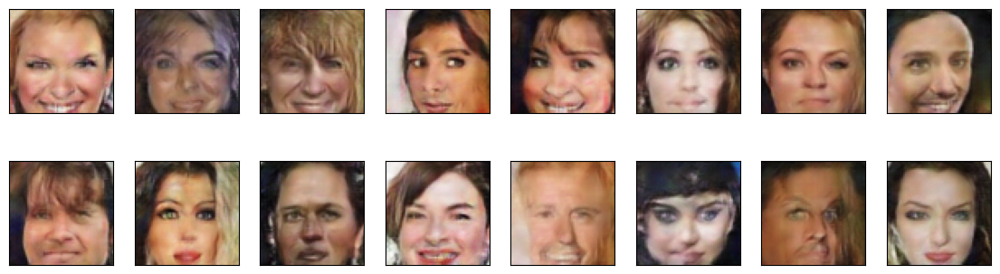

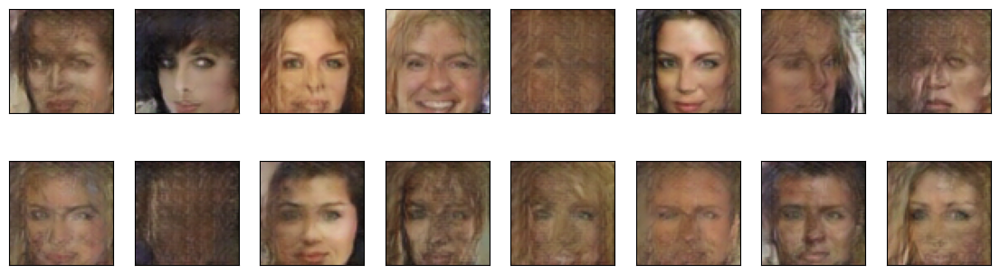

2024-01-25 00:30:01 | Epoch [29/50] | Batch 0/509 | d_loss: 0.7089 | g_loss: 1.8483
2024-01-25 00:30:04 | Epoch [29/50] | Batch 50/509 | d_loss: 0.7450 | g_loss: 1.2203
2024-01-25 00:30:07 | Epoch [29/50] | Batch 100/509 | d_loss: 0.8341 | g_loss: 2.4536
2024-01-25 00:30:10 | Epoch [29/50] | Batch 150/509 | d_loss: 0.7289 | g_loss: 1.1030
2024-01-25 00:30:13 | Epoch [29/50] | Batch 200/509 | d_loss: 0.8026 | g_loss: 1.5180
2024-01-25 00:30:16 | Epoch [29/50] | Batch 250/509 | d_loss: 0.8755 | g_loss: 2.7439
2024-01-25 00:30:19 | Epoch [29/50] | Batch 300/509 | d_loss: 0.7301 | g_loss: 1.5516
2024-01-25 00:30:22 | Epoch [29/50] | Batch 350/509 | d_loss: 0.7894 | g_loss: 1.4526
2024-01-25 00:30:25 | Epoch [29/50] | Batch 400/509 | d_loss: 0.7351 | g_loss: 1.4504
2024-01-25 00:30:28 | Epoch [29/50] | Batch 450/509 | d_loss: 1.2336 | g_loss: 2.9200
2024-01-25 00:30:31 | Epoch [29/50] | Batch 500/509 | d_loss: 0.6790 | g_loss: 1.5158


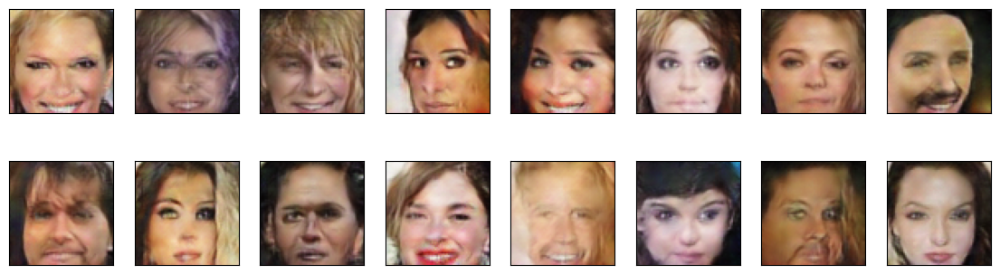

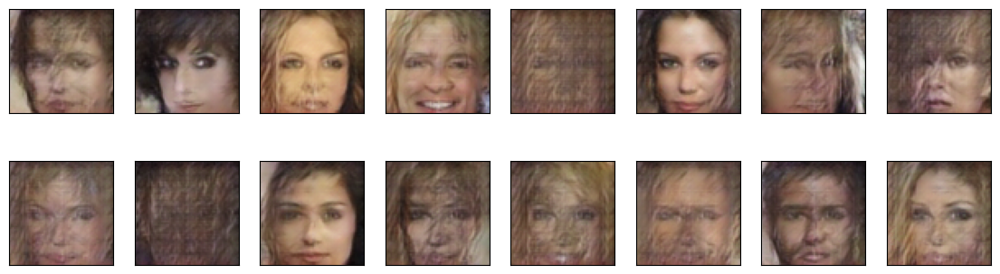

2024-01-25 00:30:32 | Epoch [30/50] | Batch 0/509 | d_loss: 0.7621 | g_loss: 1.9372
2024-01-25 00:30:35 | Epoch [30/50] | Batch 50/509 | d_loss: 1.2400 | g_loss: 3.5029
2024-01-25 00:30:38 | Epoch [30/50] | Batch 100/509 | d_loss: 0.5616 | g_loss: 1.7794
2024-01-25 00:30:41 | Epoch [30/50] | Batch 150/509 | d_loss: 1.1968 | g_loss: 1.0559
2024-01-25 00:30:44 | Epoch [30/50] | Batch 200/509 | d_loss: 0.6900 | g_loss: 1.9581
2024-01-25 00:30:47 | Epoch [30/50] | Batch 250/509 | d_loss: 0.7848 | g_loss: 2.7877
2024-01-25 00:30:50 | Epoch [30/50] | Batch 300/509 | d_loss: 0.7052 | g_loss: 1.8468
2024-01-25 00:30:53 | Epoch [30/50] | Batch 350/509 | d_loss: 0.8592 | g_loss: 1.1043
2024-01-25 00:30:56 | Epoch [30/50] | Batch 400/509 | d_loss: 1.0954 | g_loss: 4.0766
2024-01-25 00:30:59 | Epoch [30/50] | Batch 450/509 | d_loss: 0.6739 | g_loss: 2.0665
2024-01-25 00:31:02 | Epoch [30/50] | Batch 500/509 | d_loss: 0.7945 | g_loss: 1.0033


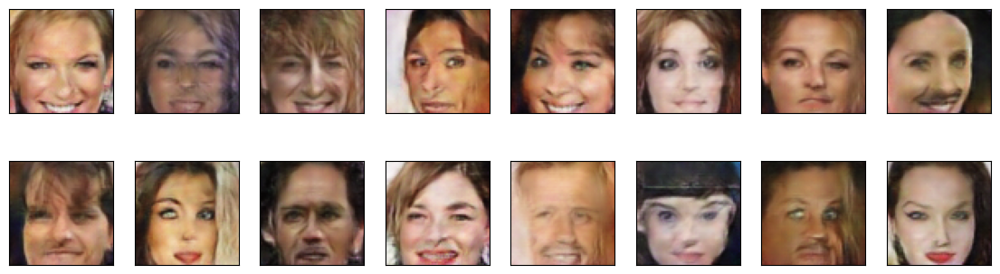

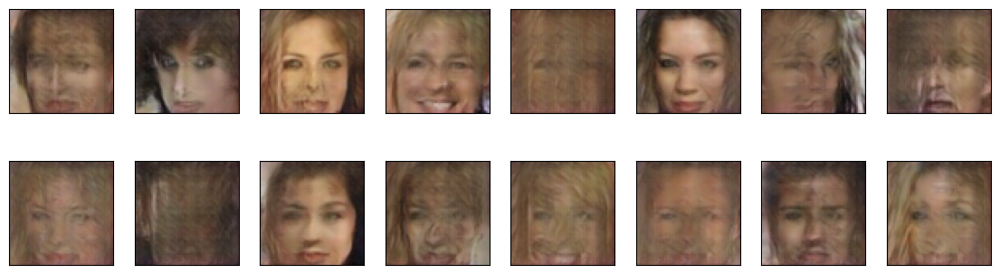

2024-01-25 00:31:03 | Epoch [31/50] | Batch 0/509 | d_loss: 0.7281 | g_loss: 1.8849
2024-01-25 00:31:06 | Epoch [31/50] | Batch 50/509 | d_loss: 0.7484 | g_loss: 1.7595
2024-01-25 00:31:09 | Epoch [31/50] | Batch 100/509 | d_loss: 0.7213 | g_loss: 2.3537
2024-01-25 00:31:12 | Epoch [31/50] | Batch 150/509 | d_loss: 0.7158 | g_loss: 1.7106
2024-01-25 00:31:15 | Epoch [31/50] | Batch 200/509 | d_loss: 1.6879 | g_loss: 2.8054
2024-01-25 00:31:18 | Epoch [31/50] | Batch 250/509 | d_loss: 0.7417 | g_loss: 1.9662
2024-01-25 00:31:21 | Epoch [31/50] | Batch 300/509 | d_loss: 0.6956 | g_loss: 1.5425
2024-01-25 00:31:24 | Epoch [31/50] | Batch 350/509 | d_loss: 0.7740 | g_loss: 2.5056
2024-01-25 00:31:27 | Epoch [31/50] | Batch 400/509 | d_loss: 0.7047 | g_loss: 1.7267
2024-01-25 00:31:30 | Epoch [31/50] | Batch 450/509 | d_loss: 1.0393 | g_loss: 1.2803
2024-01-25 00:31:33 | Epoch [31/50] | Batch 500/509 | d_loss: 0.8053 | g_loss: 1.7680


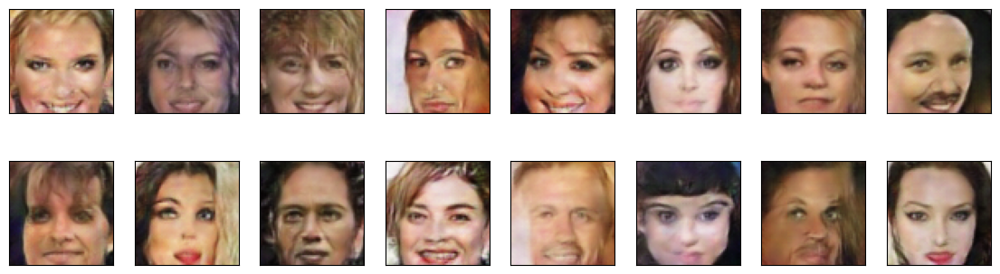

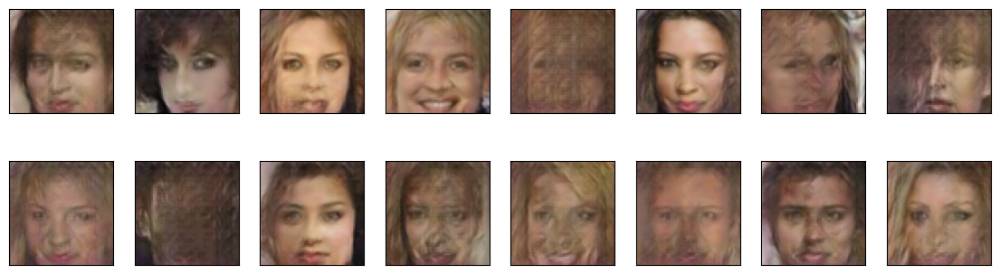

2024-01-25 00:31:35 | Epoch [32/50] | Batch 0/509 | d_loss: 0.7568 | g_loss: 1.1900
2024-01-25 00:31:38 | Epoch [32/50] | Batch 50/509 | d_loss: 0.6660 | g_loss: 2.1037
2024-01-25 00:31:40 | Epoch [32/50] | Batch 100/509 | d_loss: 0.8317 | g_loss: 2.8946
2024-01-25 00:31:43 | Epoch [32/50] | Batch 150/509 | d_loss: 0.5293 | g_loss: 2.1364
2024-01-25 00:31:46 | Epoch [32/50] | Batch 200/509 | d_loss: 0.8270 | g_loss: 2.9527
2024-01-25 00:31:49 | Epoch [32/50] | Batch 250/509 | d_loss: 0.7547 | g_loss: 1.9927
2024-01-25 00:31:52 | Epoch [32/50] | Batch 300/509 | d_loss: 0.6497 | g_loss: 2.0631
2024-01-25 00:31:55 | Epoch [32/50] | Batch 350/509 | d_loss: 0.7277 | g_loss: 2.0974
2024-01-25 00:31:58 | Epoch [32/50] | Batch 400/509 | d_loss: 0.8159 | g_loss: 1.4182
2024-01-25 00:32:01 | Epoch [32/50] | Batch 450/509 | d_loss: 0.7437 | g_loss: 1.4776
2024-01-25 00:32:04 | Epoch [32/50] | Batch 500/509 | d_loss: 0.8302 | g_loss: 1.8221


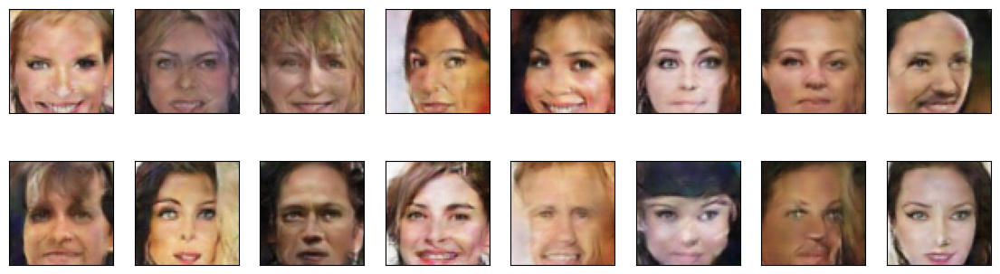

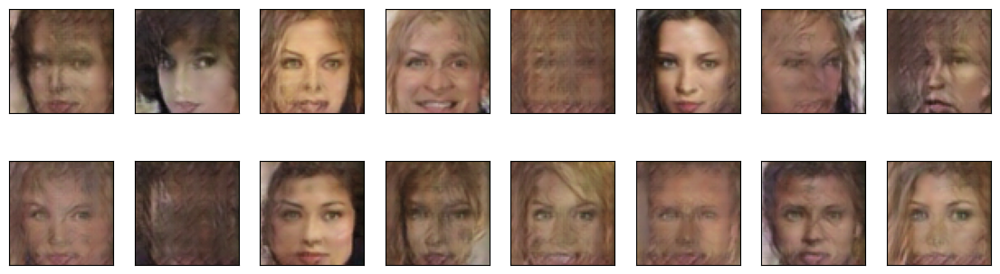

2024-01-25 00:32:06 | Epoch [33/50] | Batch 0/509 | d_loss: 0.6379 | g_loss: 1.9404
2024-01-25 00:32:09 | Epoch [33/50] | Batch 50/509 | d_loss: 0.7335 | g_loss: 1.3973
2024-01-25 00:32:12 | Epoch [33/50] | Batch 100/509 | d_loss: 0.6715 | g_loss: 1.6341
2024-01-25 00:32:15 | Epoch [33/50] | Batch 150/509 | d_loss: 0.6769 | g_loss: 2.0722
2024-01-25 00:32:17 | Epoch [33/50] | Batch 200/509 | d_loss: 0.7084 | g_loss: 1.9033
2024-01-25 00:32:20 | Epoch [33/50] | Batch 250/509 | d_loss: 0.6899 | g_loss: 2.1610
2024-01-25 00:32:23 | Epoch [33/50] | Batch 300/509 | d_loss: 0.6713 | g_loss: 1.6430
2024-01-25 00:32:26 | Epoch [33/50] | Batch 350/509 | d_loss: 0.8698 | g_loss: 3.1074
2024-01-25 00:32:29 | Epoch [33/50] | Batch 400/509 | d_loss: 0.7840 | g_loss: 2.3485
2024-01-25 00:32:32 | Epoch [33/50] | Batch 450/509 | d_loss: 0.8340 | g_loss: 2.6832
2024-01-25 00:32:35 | Epoch [33/50] | Batch 500/509 | d_loss: 1.1567 | g_loss: 3.5546


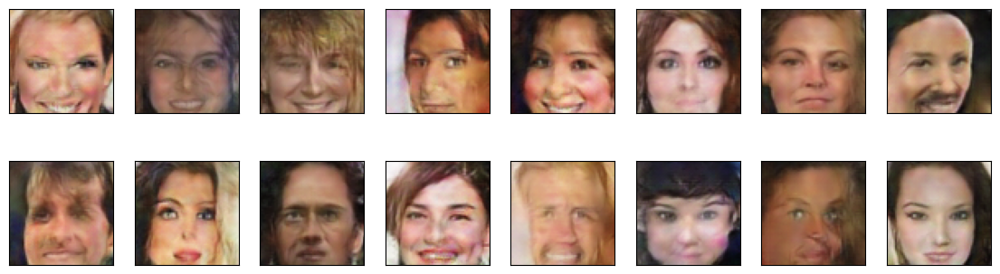

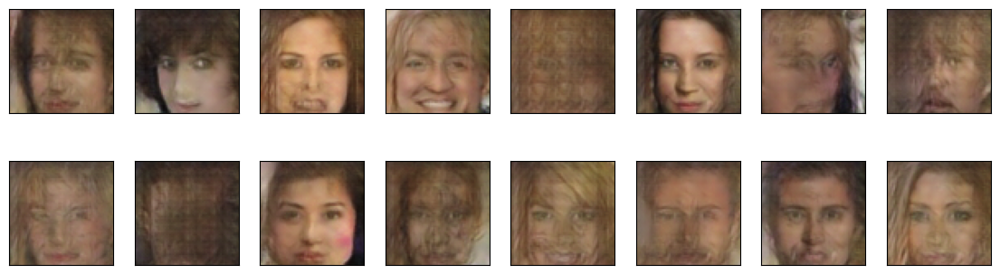

2024-01-25 00:32:37 | Epoch [34/50] | Batch 0/509 | d_loss: 0.6796 | g_loss: 2.3791
2024-01-25 00:32:40 | Epoch [34/50] | Batch 50/509 | d_loss: 0.6590 | g_loss: 2.2293
2024-01-25 00:32:43 | Epoch [34/50] | Batch 100/509 | d_loss: 0.6105 | g_loss: 1.4514
2024-01-25 00:32:46 | Epoch [34/50] | Batch 150/509 | d_loss: 0.7213 | g_loss: 1.7483
2024-01-25 00:32:49 | Epoch [34/50] | Batch 200/509 | d_loss: 0.8660 | g_loss: 2.3686
2024-01-25 00:32:51 | Epoch [34/50] | Batch 250/509 | d_loss: 0.7940 | g_loss: 1.5476
2024-01-25 00:32:54 | Epoch [34/50] | Batch 300/509 | d_loss: 0.8240 | g_loss: 2.8837
2024-01-25 00:32:57 | Epoch [34/50] | Batch 350/509 | d_loss: 0.6745 | g_loss: 1.8803
2024-01-25 00:33:00 | Epoch [34/50] | Batch 400/509 | d_loss: 0.8588 | g_loss: 1.4644
2024-01-25 00:33:03 | Epoch [34/50] | Batch 450/509 | d_loss: 0.9560 | g_loss: 1.2168
2024-01-25 00:33:06 | Epoch [34/50] | Batch 500/509 | d_loss: 0.7196 | g_loss: 0.9688


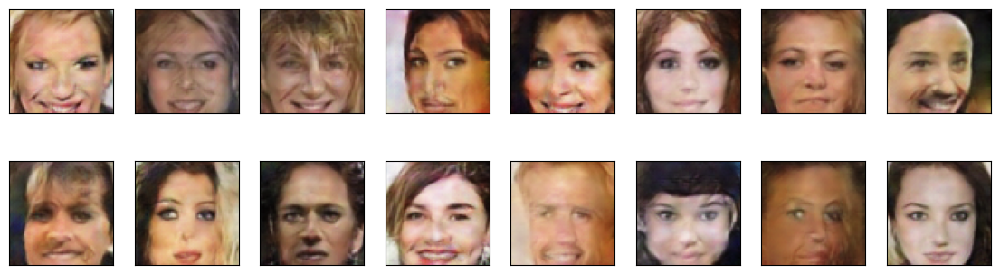

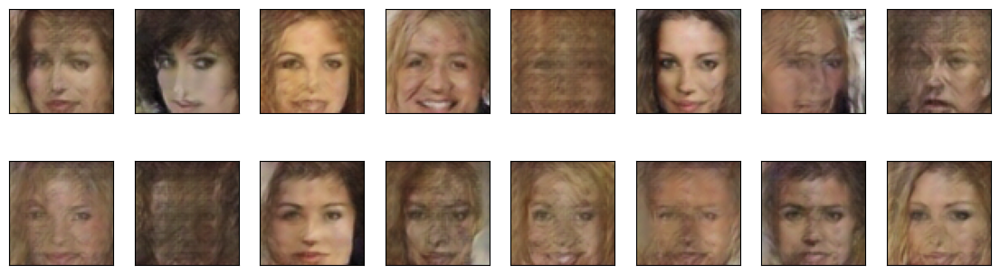

2024-01-25 00:33:08 | Epoch [35/50] | Batch 0/509 | d_loss: 0.7067 | g_loss: 1.8829
2024-01-25 00:33:11 | Epoch [35/50] | Batch 50/509 | d_loss: 0.7877 | g_loss: 1.1615
2024-01-25 00:33:14 | Epoch [35/50] | Batch 100/509 | d_loss: 0.8537 | g_loss: 2.5243
2024-01-25 00:33:17 | Epoch [35/50] | Batch 150/509 | d_loss: 0.7889 | g_loss: 2.4969
2024-01-25 00:33:20 | Epoch [35/50] | Batch 200/509 | d_loss: 0.9868 | g_loss: 1.6825
2024-01-25 00:33:23 | Epoch [35/50] | Batch 250/509 | d_loss: 0.6603 | g_loss: 1.7304
2024-01-25 00:33:26 | Epoch [35/50] | Batch 300/509 | d_loss: 0.9510 | g_loss: 2.2457
2024-01-25 00:33:28 | Epoch [35/50] | Batch 350/509 | d_loss: 0.7687 | g_loss: 2.4037
2024-01-25 00:33:31 | Epoch [35/50] | Batch 400/509 | d_loss: 0.8581 | g_loss: 1.6441
2024-01-25 00:33:34 | Epoch [35/50] | Batch 450/509 | d_loss: 0.7763 | g_loss: 1.5753
2024-01-25 00:33:37 | Epoch [35/50] | Batch 500/509 | d_loss: 0.8339 | g_loss: 1.8189


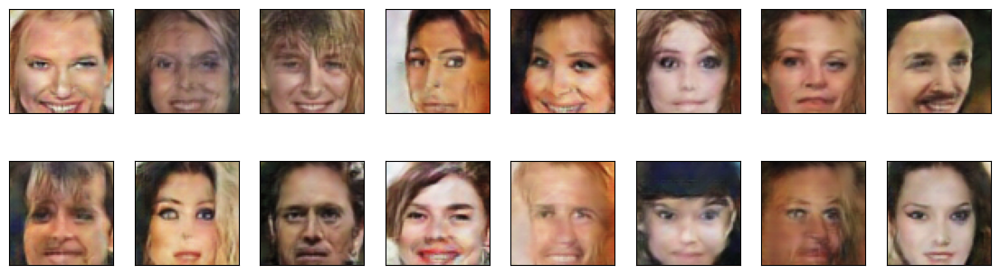

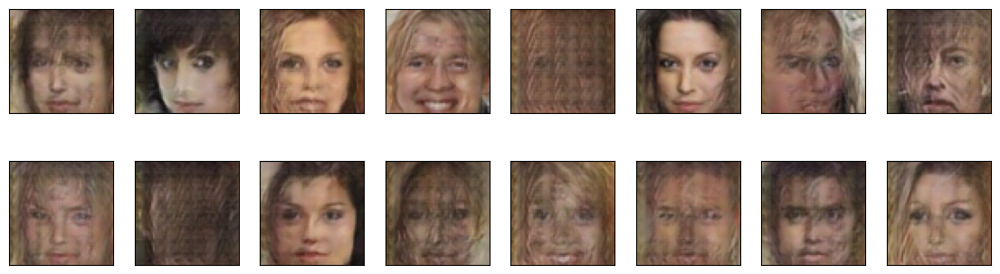

2024-01-25 00:33:39 | Epoch [36/50] | Batch 0/509 | d_loss: 0.6812 | g_loss: 2.3667
2024-01-25 00:33:42 | Epoch [36/50] | Batch 50/509 | d_loss: 0.7128 | g_loss: 2.4282
2024-01-25 00:33:45 | Epoch [36/50] | Batch 100/509 | d_loss: 0.7237 | g_loss: 1.7363
2024-01-25 00:33:48 | Epoch [36/50] | Batch 150/509 | d_loss: 0.8161 | g_loss: 0.9630
2024-01-25 00:33:51 | Epoch [36/50] | Batch 200/509 | d_loss: 0.8770 | g_loss: 2.2408
2024-01-25 00:33:54 | Epoch [36/50] | Batch 250/509 | d_loss: 0.6835 | g_loss: 1.8919
2024-01-25 00:33:57 | Epoch [36/50] | Batch 300/509 | d_loss: 0.7356 | g_loss: 1.6043
2024-01-25 00:34:00 | Epoch [36/50] | Batch 350/509 | d_loss: 0.8433 | g_loss: 2.3969
2024-01-25 00:34:02 | Epoch [36/50] | Batch 400/509 | d_loss: 0.7057 | g_loss: 1.7873
2024-01-25 00:34:05 | Epoch [36/50] | Batch 450/509 | d_loss: 0.8405 | g_loss: 3.1982
2024-01-25 00:34:08 | Epoch [36/50] | Batch 500/509 | d_loss: 0.7482 | g_loss: 2.4659


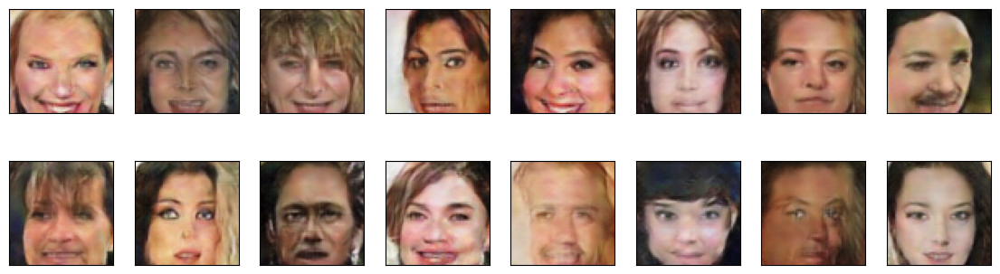

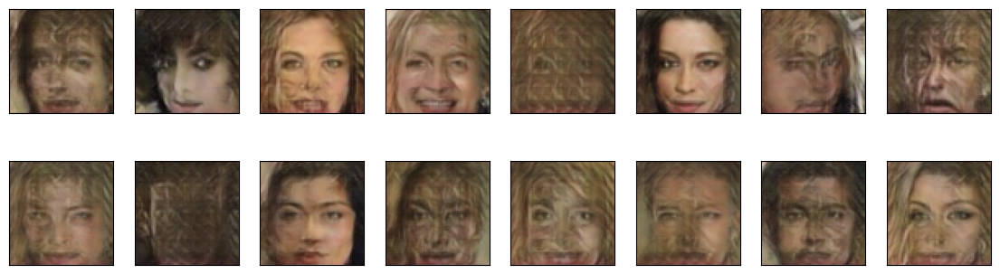

2024-01-25 00:34:10 | Epoch [37/50] | Batch 0/509 | d_loss: 1.0413 | g_loss: 0.9565
2024-01-25 00:34:13 | Epoch [37/50] | Batch 50/509 | d_loss: 0.6853 | g_loss: 2.1054
2024-01-25 00:34:16 | Epoch [37/50] | Batch 100/509 | d_loss: 0.7006 | g_loss: 1.3171
2024-01-25 00:34:19 | Epoch [37/50] | Batch 150/509 | d_loss: 0.6600 | g_loss: 1.8641
2024-01-25 00:34:22 | Epoch [37/50] | Batch 200/509 | d_loss: 0.7012 | g_loss: 1.4564
2024-01-25 00:34:25 | Epoch [37/50] | Batch 250/509 | d_loss: 0.7804 | g_loss: 1.5014
2024-01-25 00:34:28 | Epoch [37/50] | Batch 300/509 | d_loss: 0.9024 | g_loss: 1.0178
2024-01-25 00:34:31 | Epoch [37/50] | Batch 350/509 | d_loss: 0.6766 | g_loss: 1.5476
2024-01-25 00:34:34 | Epoch [37/50] | Batch 400/509 | d_loss: 0.6539 | g_loss: 2.4935
2024-01-25 00:34:37 | Epoch [37/50] | Batch 450/509 | d_loss: 0.7123 | g_loss: 1.5291
2024-01-25 00:34:40 | Epoch [37/50] | Batch 500/509 | d_loss: 0.8052 | g_loss: 1.4400


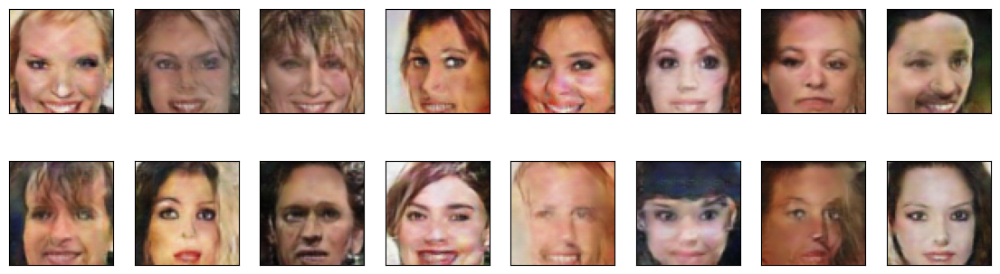

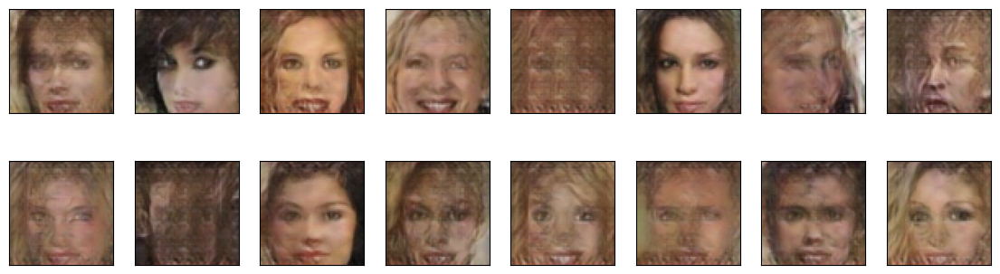

2024-01-25 00:34:41 | Epoch [38/50] | Batch 0/509 | d_loss: 0.7011 | g_loss: 1.9887
2024-01-25 00:34:44 | Epoch [38/50] | Batch 50/509 | d_loss: 0.7254 | g_loss: 1.6269
2024-01-25 00:34:47 | Epoch [38/50] | Batch 100/509 | d_loss: 0.6666 | g_loss: 1.3205
2024-01-25 00:34:50 | Epoch [38/50] | Batch 150/509 | d_loss: 0.6594 | g_loss: 1.5440
2024-01-25 00:34:53 | Epoch [38/50] | Batch 200/509 | d_loss: 0.4755 | g_loss: 1.7392
2024-01-25 00:34:56 | Epoch [38/50] | Batch 250/509 | d_loss: 0.6617 | g_loss: 1.6463
2024-01-25 00:34:59 | Epoch [38/50] | Batch 300/509 | d_loss: 0.8287 | g_loss: 1.2202
2024-01-25 00:35:02 | Epoch [38/50] | Batch 350/509 | d_loss: 0.7673 | g_loss: 1.5017
2024-01-25 00:35:05 | Epoch [38/50] | Batch 400/509 | d_loss: 0.7865 | g_loss: 1.7174
2024-01-25 00:35:08 | Epoch [38/50] | Batch 450/509 | d_loss: 0.6604 | g_loss: 1.6729
2024-01-25 00:35:11 | Epoch [38/50] | Batch 500/509 | d_loss: 0.6906 | g_loss: 1.2586


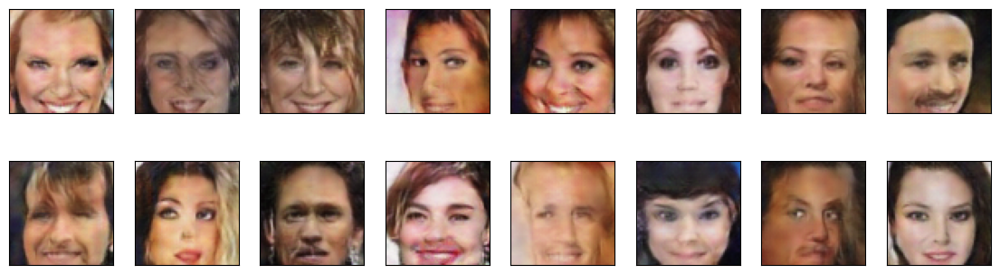

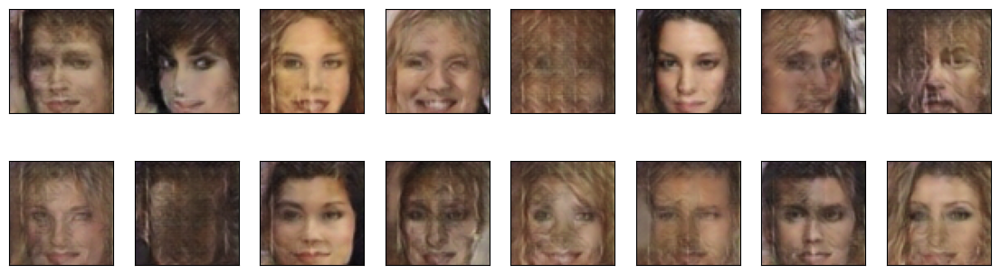

2024-01-25 00:35:13 | Epoch [39/50] | Batch 0/509 | d_loss: 0.6805 | g_loss: 1.9739
2024-01-25 00:35:15 | Epoch [39/50] | Batch 50/509 | d_loss: 0.6647 | g_loss: 1.8104
2024-01-25 00:35:18 | Epoch [39/50] | Batch 100/509 | d_loss: 0.8698 | g_loss: 1.5183
2024-01-25 00:35:21 | Epoch [39/50] | Batch 150/509 | d_loss: 0.6514 | g_loss: 1.9120
2024-01-25 00:35:24 | Epoch [39/50] | Batch 200/509 | d_loss: 0.8113 | g_loss: 1.4797
2024-01-25 00:35:27 | Epoch [39/50] | Batch 250/509 | d_loss: 0.8264 | g_loss: 2.9906
2024-01-25 00:35:30 | Epoch [39/50] | Batch 300/509 | d_loss: 0.6312 | g_loss: 2.0582
2024-01-25 00:35:33 | Epoch [39/50] | Batch 350/509 | d_loss: 0.7693 | g_loss: 2.1217
2024-01-25 00:35:36 | Epoch [39/50] | Batch 400/509 | d_loss: 1.1825 | g_loss: 0.7919
2024-01-25 00:35:39 | Epoch [39/50] | Batch 450/509 | d_loss: 0.7773 | g_loss: 2.4686
2024-01-25 00:35:42 | Epoch [39/50] | Batch 500/509 | d_loss: 0.7357 | g_loss: 1.3358


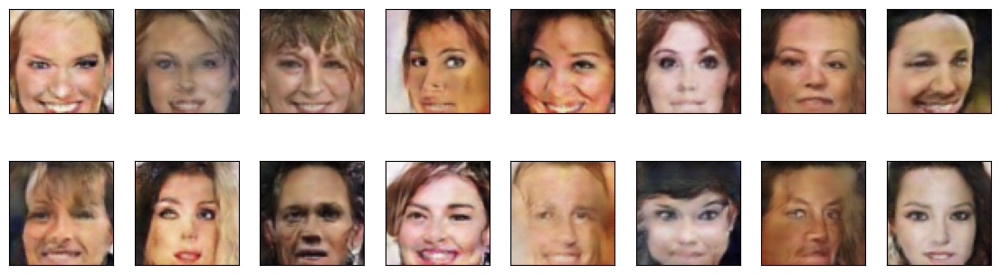

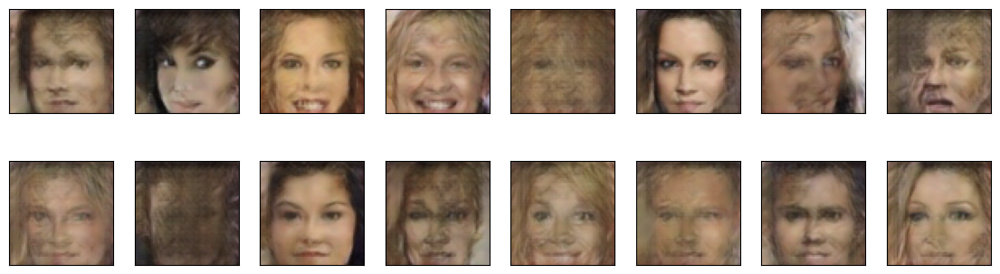

2024-01-25 00:35:44 | Epoch [40/50] | Batch 0/509 | d_loss: 0.7480 | g_loss: 2.2096
2024-01-25 00:35:47 | Epoch [40/50] | Batch 50/509 | d_loss: 0.7563 | g_loss: 1.0103
2024-01-25 00:35:49 | Epoch [40/50] | Batch 100/509 | d_loss: 1.2958 | g_loss: 0.6966
2024-01-25 00:35:52 | Epoch [40/50] | Batch 150/509 | d_loss: 0.6166 | g_loss: 1.7903
2024-01-25 00:35:55 | Epoch [40/50] | Batch 200/509 | d_loss: 0.6344 | g_loss: 1.6818
2024-01-25 00:35:58 | Epoch [40/50] | Batch 250/509 | d_loss: 0.7288 | g_loss: 1.1458
2024-01-25 00:36:01 | Epoch [40/50] | Batch 300/509 | d_loss: 0.7298 | g_loss: 0.8597
2024-01-25 00:36:04 | Epoch [40/50] | Batch 350/509 | d_loss: 0.6412 | g_loss: 1.7874
2024-01-25 00:36:07 | Epoch [40/50] | Batch 400/509 | d_loss: 0.8624 | g_loss: 1.9866
2024-01-25 00:36:10 | Epoch [40/50] | Batch 450/509 | d_loss: 1.2873 | g_loss: 1.8101
2024-01-25 00:36:13 | Epoch [40/50] | Batch 500/509 | d_loss: 0.8747 | g_loss: 1.5185


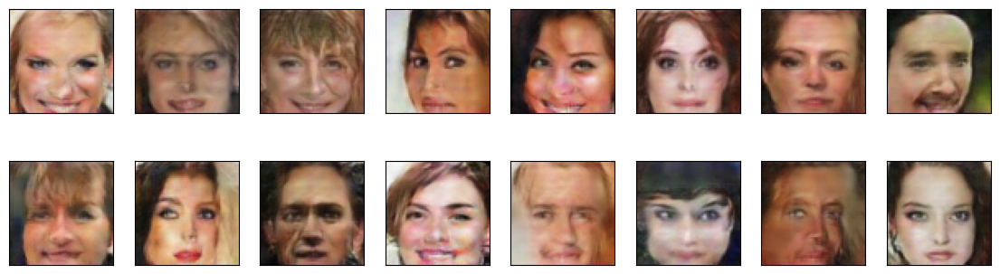

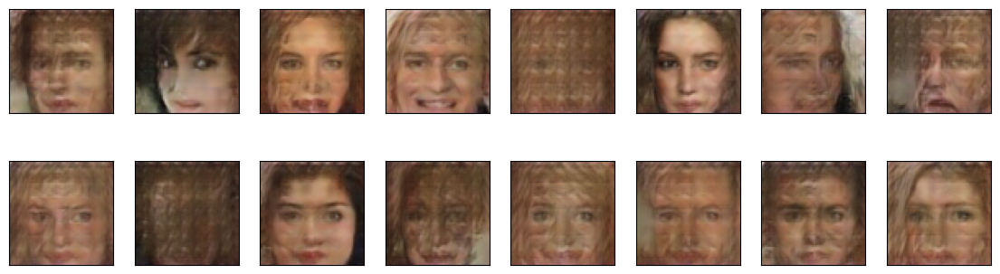

2024-01-25 00:36:15 | Epoch [41/50] | Batch 0/509 | d_loss: 0.6748 | g_loss: 2.4453
2024-01-25 00:36:18 | Epoch [41/50] | Batch 50/509 | d_loss: 0.6868 | g_loss: 2.3826
2024-01-25 00:36:21 | Epoch [41/50] | Batch 100/509 | d_loss: 0.7437 | g_loss: 2.1387
2024-01-25 00:36:24 | Epoch [41/50] | Batch 150/509 | d_loss: 0.6510 | g_loss: 1.8818
2024-01-25 00:36:26 | Epoch [41/50] | Batch 200/509 | d_loss: 1.4832 | g_loss: 0.1849
2024-01-25 00:36:29 | Epoch [41/50] | Batch 250/509 | d_loss: 0.6538 | g_loss: 2.1610
2024-01-25 00:36:32 | Epoch [41/50] | Batch 300/509 | d_loss: 0.6305 | g_loss: 1.6546
2024-01-25 00:36:35 | Epoch [41/50] | Batch 350/509 | d_loss: 0.7827 | g_loss: 1.2084
2024-01-25 00:36:38 | Epoch [41/50] | Batch 400/509 | d_loss: 0.8726 | g_loss: 1.0254
2024-01-25 00:36:41 | Epoch [41/50] | Batch 450/509 | d_loss: 0.7078 | g_loss: 2.5532
2024-01-25 00:36:44 | Epoch [41/50] | Batch 500/509 | d_loss: 0.8079 | g_loss: 1.9238


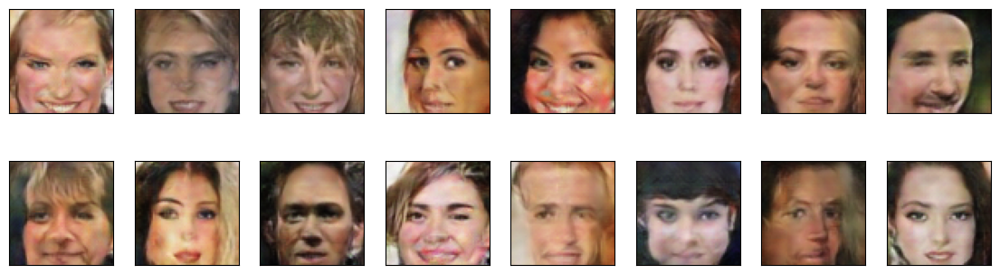

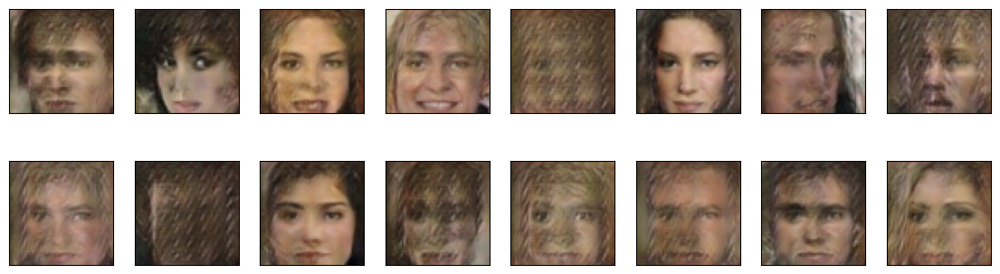

2024-01-25 00:36:46 | Epoch [42/50] | Batch 0/509 | d_loss: 0.6453 | g_loss: 1.9706
2024-01-25 00:36:49 | Epoch [42/50] | Batch 50/509 | d_loss: 0.7665 | g_loss: 1.4349
2024-01-25 00:36:52 | Epoch [42/50] | Batch 100/509 | d_loss: 0.8890 | g_loss: 2.1449
2024-01-25 00:36:55 | Epoch [42/50] | Batch 150/509 | d_loss: 0.7079 | g_loss: 1.6152
2024-01-25 00:36:58 | Epoch [42/50] | Batch 200/509 | d_loss: 0.7084 | g_loss: 1.6523
2024-01-25 00:37:01 | Epoch [42/50] | Batch 250/509 | d_loss: 0.7638 | g_loss: 1.6553
2024-01-25 00:37:03 | Epoch [42/50] | Batch 300/509 | d_loss: 0.7234 | g_loss: 1.1045
2024-01-25 00:37:06 | Epoch [42/50] | Batch 350/509 | d_loss: 0.7297 | g_loss: 2.2069
2024-01-25 00:37:09 | Epoch [42/50] | Batch 400/509 | d_loss: 0.7347 | g_loss: 1.2717
2024-01-25 00:37:12 | Epoch [42/50] | Batch 450/509 | d_loss: 0.8482 | g_loss: 1.5820
2024-01-25 00:37:15 | Epoch [42/50] | Batch 500/509 | d_loss: 1.0811 | g_loss: 2.9402


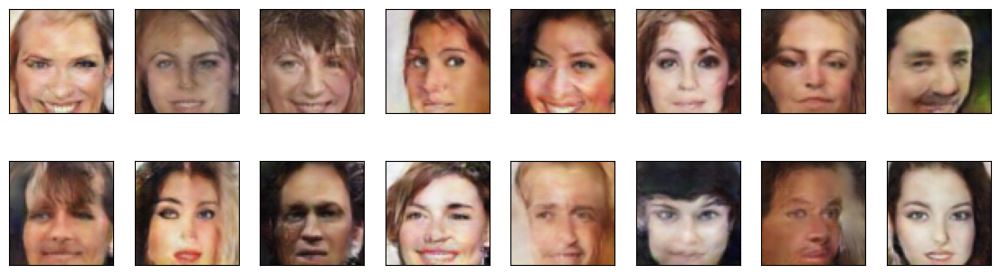

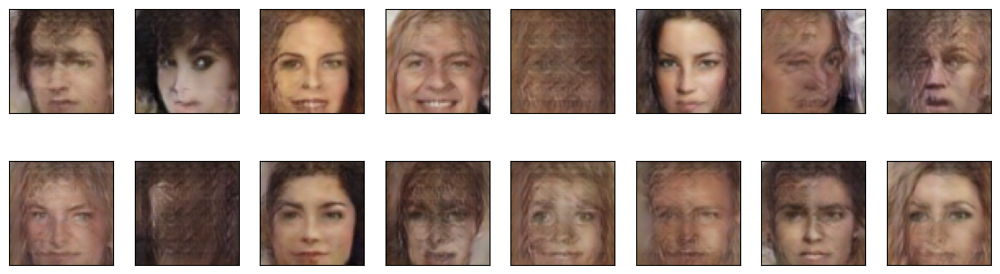

2024-01-25 00:37:17 | Epoch [43/50] | Batch 0/509 | d_loss: 1.1591 | g_loss: 0.8147
2024-01-25 00:37:20 | Epoch [43/50] | Batch 50/509 | d_loss: 0.6314 | g_loss: 1.0252
2024-01-25 00:37:23 | Epoch [43/50] | Batch 100/509 | d_loss: 0.6429 | g_loss: 1.3881
2024-01-25 00:37:26 | Epoch [43/50] | Batch 150/509 | d_loss: 0.7490 | g_loss: 2.4794
2024-01-25 00:37:29 | Epoch [43/50] | Batch 200/509 | d_loss: 0.8068 | g_loss: 2.4127
2024-01-25 00:37:32 | Epoch [43/50] | Batch 250/509 | d_loss: 0.6988 | g_loss: 2.0348
2024-01-25 00:37:34 | Epoch [43/50] | Batch 300/509 | d_loss: 1.2803 | g_loss: 3.4292
2024-01-25 00:37:37 | Epoch [43/50] | Batch 350/509 | d_loss: 0.6980 | g_loss: 1.7472
2024-01-25 00:37:40 | Epoch [43/50] | Batch 400/509 | d_loss: 0.6869 | g_loss: 2.0588
2024-01-25 00:37:43 | Epoch [43/50] | Batch 450/509 | d_loss: 0.6651 | g_loss: 1.3208
2024-01-25 00:37:46 | Epoch [43/50] | Batch 500/509 | d_loss: 0.8062 | g_loss: 1.2490


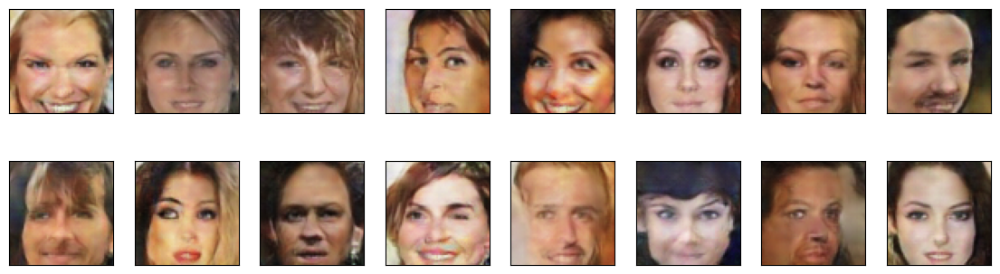

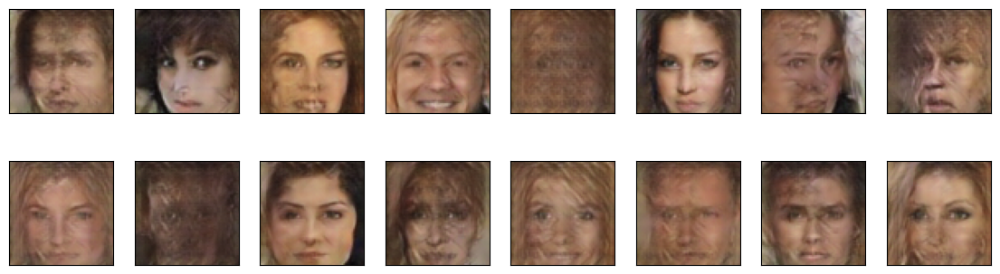

2024-01-25 00:37:48 | Epoch [44/50] | Batch 0/509 | d_loss: 0.7000 | g_loss: 2.1159
2024-01-25 00:37:51 | Epoch [44/50] | Batch 50/509 | d_loss: 0.6483 | g_loss: 1.6515
2024-01-25 00:37:54 | Epoch [44/50] | Batch 100/509 | d_loss: 0.6729 | g_loss: 2.6268
2024-01-25 00:37:57 | Epoch [44/50] | Batch 150/509 | d_loss: 1.0683 | g_loss: 2.7747
2024-01-25 00:38:00 | Epoch [44/50] | Batch 200/509 | d_loss: 0.7354 | g_loss: 1.9767
2024-01-25 00:38:03 | Epoch [44/50] | Batch 250/509 | d_loss: 0.6616 | g_loss: 1.7220
2024-01-25 00:38:06 | Epoch [44/50] | Batch 300/509 | d_loss: 0.6098 | g_loss: 2.1333
2024-01-25 00:38:08 | Epoch [44/50] | Batch 350/509 | d_loss: 1.0809 | g_loss: 1.3799
2024-01-25 00:38:11 | Epoch [44/50] | Batch 400/509 | d_loss: 0.6366 | g_loss: 1.7761
2024-01-25 00:38:14 | Epoch [44/50] | Batch 450/509 | d_loss: 0.6660 | g_loss: 1.9421
2024-01-25 00:38:17 | Epoch [44/50] | Batch 500/509 | d_loss: 0.7360 | g_loss: 2.3557


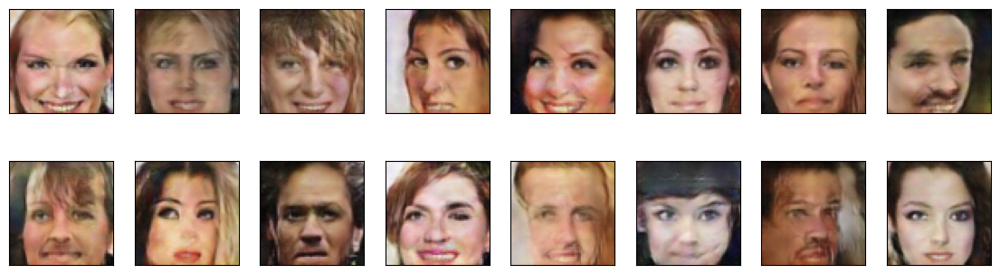

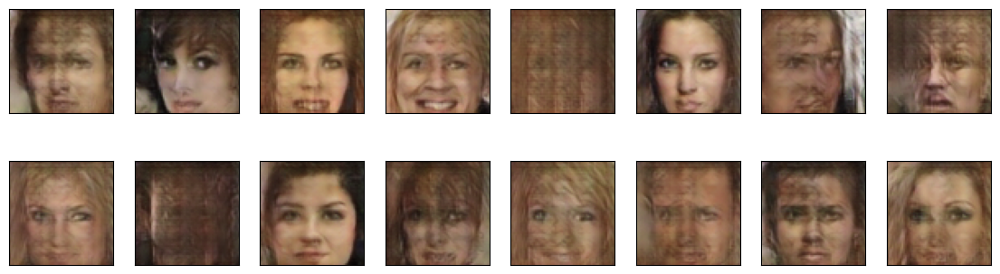

2024-01-25 00:38:19 | Epoch [45/50] | Batch 0/509 | d_loss: 0.7527 | g_loss: 1.7332
2024-01-25 00:38:22 | Epoch [45/50] | Batch 50/509 | d_loss: 0.6748 | g_loss: 2.2338
2024-01-25 00:38:25 | Epoch [45/50] | Batch 100/509 | d_loss: 0.8551 | g_loss: 1.5940
2024-01-25 00:38:28 | Epoch [45/50] | Batch 150/509 | d_loss: 0.7031 | g_loss: 2.1194
2024-01-25 00:38:31 | Epoch [45/50] | Batch 200/509 | d_loss: 0.6428 | g_loss: 1.4778
2024-01-25 00:38:34 | Epoch [45/50] | Batch 250/509 | d_loss: 0.5473 | g_loss: 2.5364
2024-01-25 00:38:37 | Epoch [45/50] | Batch 300/509 | d_loss: 0.8229 | g_loss: 2.4775
2024-01-25 00:38:40 | Epoch [45/50] | Batch 350/509 | d_loss: 0.8448 | g_loss: 1.3416
2024-01-25 00:38:43 | Epoch [45/50] | Batch 400/509 | d_loss: 0.7613 | g_loss: 1.9273
2024-01-25 00:38:45 | Epoch [45/50] | Batch 450/509 | d_loss: 0.7017 | g_loss: 1.9681
2024-01-25 00:38:48 | Epoch [45/50] | Batch 500/509 | d_loss: 0.8208 | g_loss: 1.4405


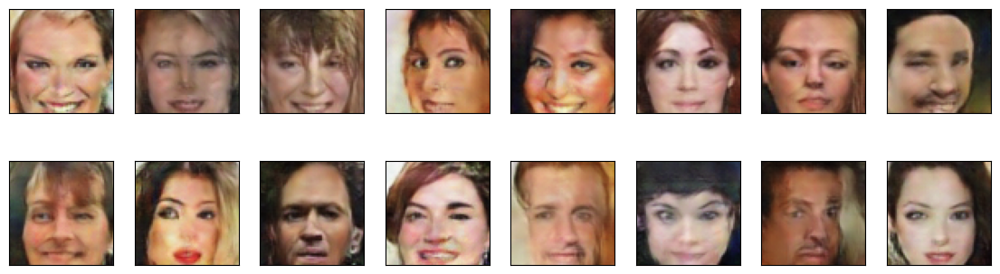

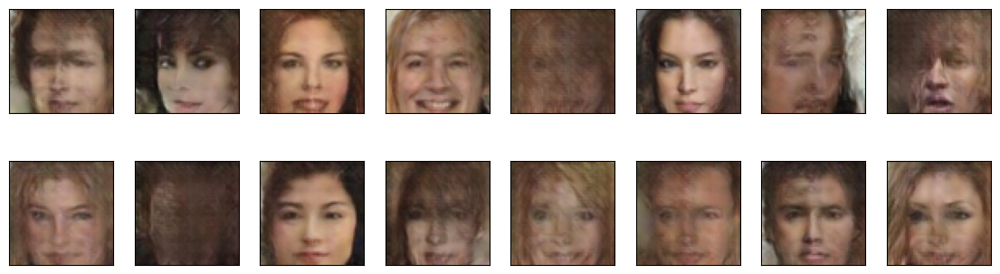

2024-01-25 00:38:50 | Epoch [46/50] | Batch 0/509 | d_loss: 0.5863 | g_loss: 1.4751
2024-01-25 00:38:53 | Epoch [46/50] | Batch 50/509 | d_loss: 0.7640 | g_loss: 1.2360
2024-01-25 00:38:56 | Epoch [46/50] | Batch 100/509 | d_loss: 0.8676 | g_loss: 2.6867
2024-01-25 00:38:59 | Epoch [46/50] | Batch 150/509 | d_loss: 0.7761 | g_loss: 1.3547
2024-01-25 00:39:02 | Epoch [46/50] | Batch 200/509 | d_loss: 0.6519 | g_loss: 2.1158
2024-01-25 00:39:05 | Epoch [46/50] | Batch 250/509 | d_loss: 0.7315 | g_loss: 1.2871
2024-01-25 00:39:08 | Epoch [46/50] | Batch 300/509 | d_loss: 0.7627 | g_loss: 1.2671
2024-01-25 00:39:11 | Epoch [46/50] | Batch 350/509 | d_loss: 0.8073 | g_loss: 2.3915
2024-01-25 00:39:14 | Epoch [46/50] | Batch 400/509 | d_loss: 0.7755 | g_loss: 2.5391
2024-01-25 00:39:17 | Epoch [46/50] | Batch 450/509 | d_loss: 0.6338 | g_loss: 1.8406
2024-01-25 00:39:20 | Epoch [46/50] | Batch 500/509 | d_loss: 0.9047 | g_loss: 1.1922


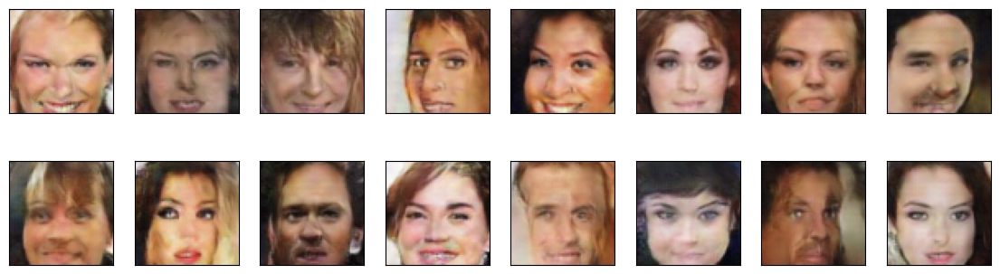

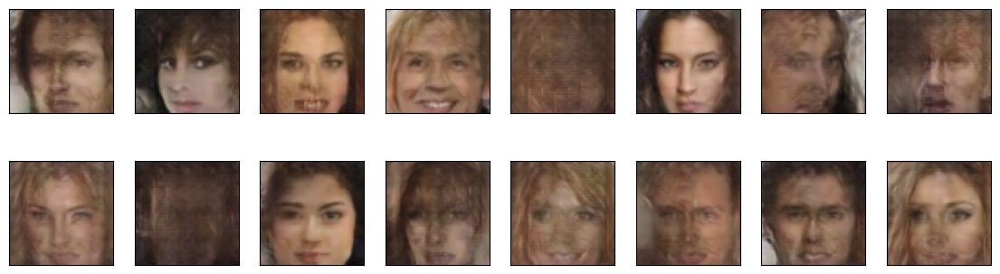

2024-01-25 00:39:21 | Epoch [47/50] | Batch 0/509 | d_loss: 0.7689 | g_loss: 1.7790
2024-01-25 00:39:24 | Epoch [47/50] | Batch 50/509 | d_loss: 0.4947 | g_loss: 1.4835
2024-01-25 00:39:27 | Epoch [47/50] | Batch 100/509 | d_loss: 0.6812 | g_loss: 1.9089
2024-01-25 00:39:30 | Epoch [47/50] | Batch 150/509 | d_loss: 0.9731 | g_loss: 0.8724
2024-01-25 00:39:33 | Epoch [47/50] | Batch 200/509 | d_loss: 0.7952 | g_loss: 1.2818
2024-01-25 00:39:36 | Epoch [47/50] | Batch 250/509 | d_loss: 2.2920 | g_loss: 2.1418
2024-01-25 00:39:39 | Epoch [47/50] | Batch 300/509 | d_loss: 0.8715 | g_loss: 2.5842
2024-01-25 00:39:42 | Epoch [47/50] | Batch 350/509 | d_loss: 0.6650 | g_loss: 1.7038
2024-01-25 00:39:45 | Epoch [47/50] | Batch 400/509 | d_loss: 0.6150 | g_loss: 2.0186
2024-01-25 00:39:48 | Epoch [47/50] | Batch 450/509 | d_loss: 0.6466 | g_loss: 1.2219
2024-01-25 00:39:51 | Epoch [47/50] | Batch 500/509 | d_loss: 0.6722 | g_loss: 1.6706


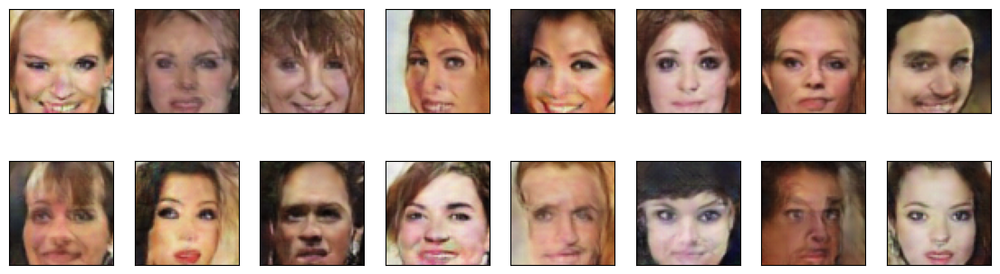

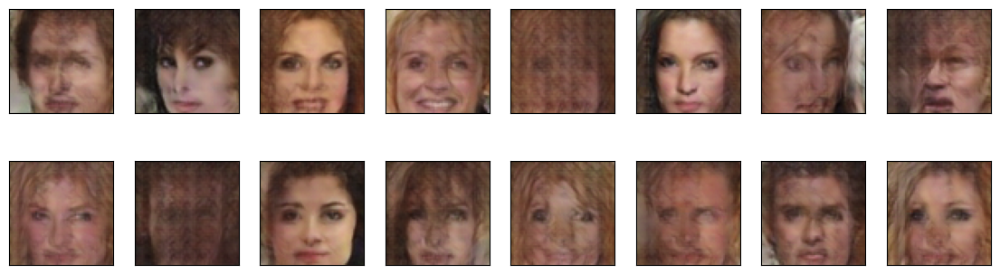

2024-01-25 00:39:53 | Epoch [48/50] | Batch 0/509 | d_loss: 0.7653 | g_loss: 2.0785
2024-01-25 00:39:55 | Epoch [48/50] | Batch 50/509 | d_loss: 0.7507 | g_loss: 1.3327
2024-01-25 00:39:58 | Epoch [48/50] | Batch 100/509 | d_loss: 0.8176 | g_loss: 1.2331
2024-01-25 00:40:01 | Epoch [48/50] | Batch 150/509 | d_loss: 0.6647 | g_loss: 1.6311
2024-01-25 00:40:04 | Epoch [48/50] | Batch 200/509 | d_loss: 0.8854 | g_loss: 1.3035
2024-01-25 00:40:07 | Epoch [48/50] | Batch 250/509 | d_loss: 0.6227 | g_loss: 1.4381
2024-01-25 00:40:10 | Epoch [48/50] | Batch 300/509 | d_loss: 0.6851 | g_loss: 1.7962
2024-01-25 00:40:13 | Epoch [48/50] | Batch 350/509 | d_loss: 0.7194 | g_loss: 1.5468
2024-01-25 00:40:16 | Epoch [48/50] | Batch 400/509 | d_loss: 0.7031 | g_loss: 1.2601
2024-01-25 00:40:19 | Epoch [48/50] | Batch 450/509 | d_loss: 0.7864 | g_loss: 2.0010
2024-01-25 00:40:22 | Epoch [48/50] | Batch 500/509 | d_loss: 0.7732 | g_loss: 2.0770


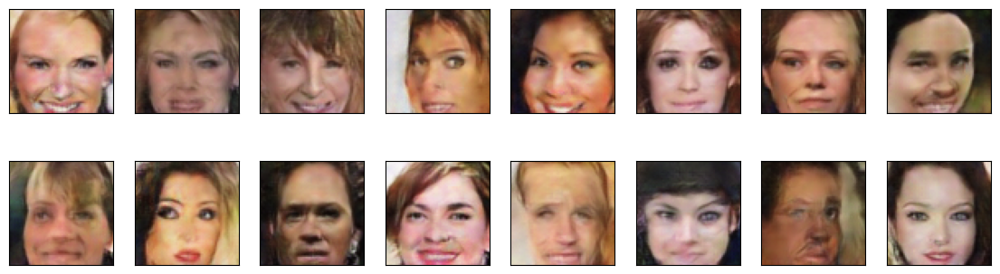

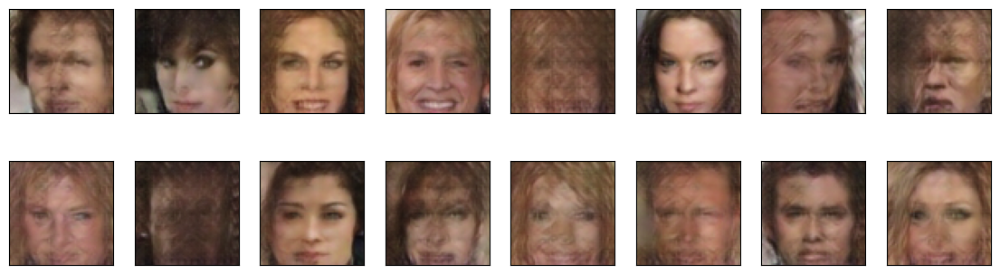

2024-01-25 00:40:24 | Epoch [49/50] | Batch 0/509 | d_loss: 0.5858 | g_loss: 1.9052
2024-01-25 00:40:27 | Epoch [49/50] | Batch 50/509 | d_loss: 0.6456 | g_loss: 2.6196
2024-01-25 00:40:30 | Epoch [49/50] | Batch 100/509 | d_loss: 0.7013 | g_loss: 2.1825
2024-01-25 00:40:32 | Epoch [49/50] | Batch 150/509 | d_loss: 0.6549 | g_loss: 1.7884
2024-01-25 00:40:35 | Epoch [49/50] | Batch 200/509 | d_loss: 0.6521 | g_loss: 2.3197
2024-01-25 00:40:38 | Epoch [49/50] | Batch 250/509 | d_loss: 0.6641 | g_loss: 1.6326
2024-01-25 00:40:41 | Epoch [49/50] | Batch 300/509 | d_loss: 0.6792 | g_loss: 1.5957
2024-01-25 00:40:44 | Epoch [49/50] | Batch 350/509 | d_loss: 0.7326 | g_loss: 2.2648
2024-01-25 00:40:47 | Epoch [49/50] | Batch 400/509 | d_loss: 0.6037 | g_loss: 2.2382
2024-01-25 00:40:50 | Epoch [49/50] | Batch 450/509 | d_loss: 0.7178 | g_loss: 1.2690
2024-01-25 00:40:53 | Epoch [49/50] | Batch 500/509 | d_loss: 0.8382 | g_loss: 1.9323


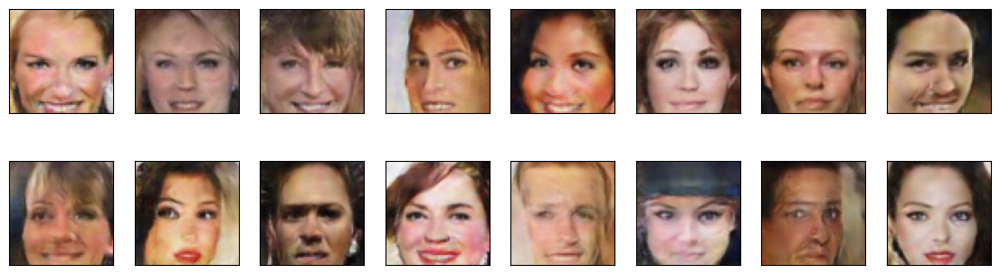

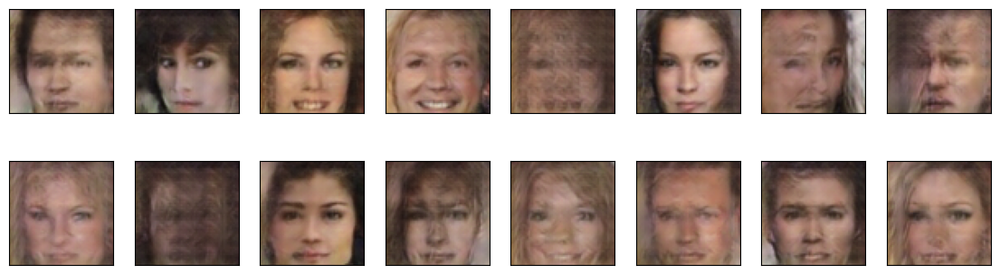

2024-01-25 00:40:55 | Epoch [50/50] | Batch 0/509 | d_loss: 0.6696 | g_loss: 2.3759
2024-01-25 00:40:58 | Epoch [50/50] | Batch 50/509 | d_loss: 0.6939 | g_loss: 1.0405
2024-01-25 00:41:01 | Epoch [50/50] | Batch 100/509 | d_loss: 0.8366 | g_loss: 2.6709
2024-01-25 00:41:03 | Epoch [50/50] | Batch 150/509 | d_loss: 0.6441 | g_loss: 1.7315
2024-01-25 00:41:06 | Epoch [50/50] | Batch 200/509 | d_loss: 0.7080 | g_loss: 1.9338
2024-01-25 00:41:09 | Epoch [50/50] | Batch 250/509 | d_loss: 0.7674 | g_loss: 2.8838
2024-01-25 00:41:12 | Epoch [50/50] | Batch 300/509 | d_loss: 0.8206 | g_loss: 1.6954
2024-01-25 00:41:15 | Epoch [50/50] | Batch 350/509 | d_loss: 0.6184 | g_loss: 1.8957
2024-01-25 00:41:18 | Epoch [50/50] | Batch 400/509 | d_loss: 1.0343 | g_loss: 1.7156
2024-01-25 00:41:21 | Epoch [50/50] | Batch 450/509 | d_loss: 0.7530 | g_loss: 2.0142
2024-01-25 00:41:24 | Epoch [50/50] | Batch 500/509 | d_loss: 0.6892 | g_loss: 2.0147


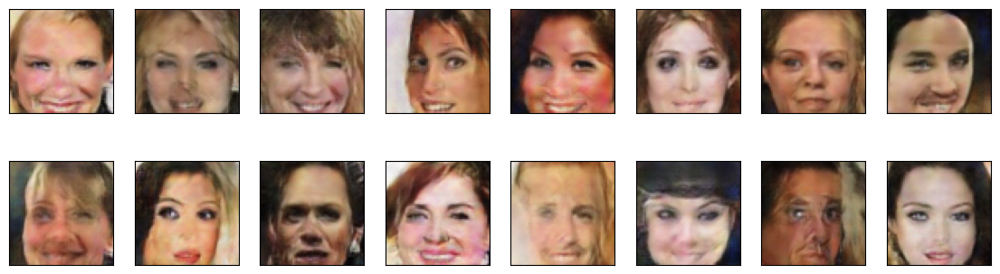

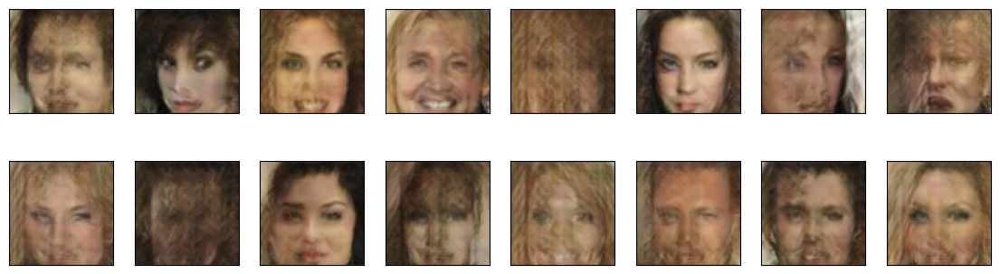

In [82]:
fixed_latent_vector = torch.randn(16, latent_dim, 1, 1).float().cuda()
fixed_latent_vector = fixed_latent_vector.to(device)

fixed_latent_vector_uniform = np.random.uniform(-1, 1, size=(16, latent_dim))
fixed_latent_vector_uniform = torch.from_numpy(fixed_latent_vector_uniform).float()[:,:,None,None]    
fixed_latent_vector_uniform = fixed_latent_vector_uniform.to(device)

losses = []
for epoch in range(n_epochs):
    for batch_i, real_images in enumerate(dataloader):
        real_images = real_images.to(device)            
                
        # TRAIN THE DISCRIMINATOR        
        d_loss = discriminator_step(batch_size, latent_dim, real_images)
        
        
        # TRAIN THE GENERATOR        
        g_loss = generator_step(batch_size, latent_dim)

        ####################################
        
        if batch_i % print_every == 0:
            # append discriminator loss and generator loss
            d = d_loss['loss'].item()
            g = g_loss['loss'].item()
            losses.append((d, g))
            # print discriminator and generator loss
            time = str(datetime.now()).split('.')[0]
            print(f'{time} | Epoch [{epoch+1}/{n_epochs}] | Batch {batch_i}/{len(dataloader)} | d_loss: {d:.4f} | g_loss: {g:.4f}')
    
    # display images during training
    generator.eval()
    generated_images = generator(fixed_latent_vector)
    display(generated_images)
    generated_images = generator(fixed_latent_vector_uniform)
    display(generated_images)
    generator.train()

### Training losses

Plot the training losses for the generator and discriminator.

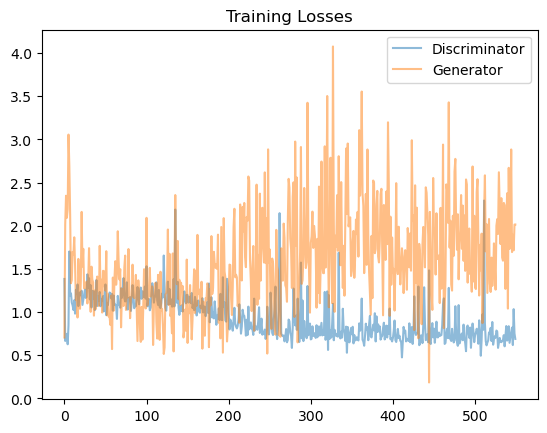

In [83]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

### Question: What do you notice about your generated samples and how might you improve this model?
When you answer this question, consider the following factors:
* The dataset is biased; it is made of "celebrity" faces that are mostly white
* Model size; larger models have the opportunity to learn more features in a data feature space
* Optimization strategy; optimizers and number of epochs affect your final result
* Loss functions

**Answer:** (Write your answer in this cell)

About the dataset, perhaps there is bias, although the 20 samples in the beginning of the notebook does have an interesting coverage at least accross genders. Races not so much. 
Nevertheless, I believe a bigger dataset could give better results.

In terms of experiments, I started with architecture and hyperparameters somewhat based on DCGAN paper, to try to avoid some of the GAN training instability that's usually mentioned on related documentation and on the course material.

The GAN was initially trained using latent vectors generated from an uniform distribution between (-1, 1) and I noticed that the model performs worse on generating images for latent vectors from a gaussian/normal distribution. Besides the original 'fixed_latent_vector', I also introduced an 'fixed_latent_vector_uniform' variable, to compare the results over training epochs.

Introducing weight initialization reduced the observed max generated loss.

Then introducing label smoothing to reduce label of real pictures to 0.9, reduced the observed max generated loss. Discriminator loss seems to be around 0.5, which is a good indicator.

Switching to generating latent vectors using a Normal distribution apparently stabilized GAN training, where d-loss seems to be around one fixed value and g-loss is no longer steadily increasing. However, from a subjective perspective, the generated faces seems to be blurrier in the last epochs.

The next enhancement as my attempt to make discriminator training harder was to do label smoothing for both real and fake pictures and in a higher range - 0.7 to 1.2 and 0 to 3, respectively. That was inspired by this talk: https://www.youtube.com/watch?v=myGAju4L7O8. Results seems to be even better, where discriminator loss took more epochs to stabilize, which apparently gave more room for the generator to evolve, so that its max loss has the least value I had seen in all my experiments.

Next steps could be more attempts to make discriminator even harder, and perhaps switching DCGAN architecture to a more modern architecture and eventually introducing gradient penalty if switching Binary Cross Entropy with a different loss function

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb".  

Submit the notebook using the ***SUBMIT*** button in the bottom right corner of the Project Workspace.